In [ ]:
import os
import shutil

# Define the base directory name
base_dir = 'Jenis Daging'

# Check if the directory exists
if os.path.exists(base_dir) and os.path.isdir(base_dir):
    print(f"Directory '{base_dir}' found. Deleting it and its contents...")
    try:
        shutil.rmtree(base_dir)
        print(f"Directory '{base_dir}' and its contents successfully deleted.")
    except OSError as e:
        print(f"Error: Could not delete directory '{base_dir}'. Reason: {e}")
else:
    print(f"Directory '{base_dir}' not found. Proceeding to the next Colab cell.")

Directory 'Jenis Daging' found. Deleting it and its contents...
Directory 'Jenis Daging' and its contents successfully deleted.


In [ ]:
import os
import shutil
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.applications import  MobileNetV2 # Menggunakan ResNet50
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau, ModelCheckpoint
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import classification_report, confusion_matrix
import seaborn as sns
from google.colab import drive

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
!unzip '/content/drive/MyDrive/PI/Train/Jenis Daging'


Archive:  /content/drive/MyDrive/PI/Train/Jenis Daging.zip
   creating: Jenis Daging/
   creating: Jenis Daging/test/
   creating: Jenis Daging/test/Chicken/
  inflating: Jenis Daging/test/Chicken/segar_0001_jpg.rf.2b7c7688b49f27570b790639a49077a0.jpg  
  inflating: Jenis Daging/test/Chicken/segar_0002_jpg.rf.6a36c3f3000a35d008a15d9175c7dbf2.jpg  
  inflating: Jenis Daging/test/Chicken/segar_0003_jpg.rf.d9d9f18228956e2c55716cfdfec46d3d.jpg  
  inflating: Jenis Daging/test/Chicken/segar_0006_jpg.rf.2b12e3ca3e3b28eeec14e171bab5f8be.jpg  
  inflating: Jenis Daging/test/Chicken/segar_0007_jpg.rf.95121e5360a259e5e94a6c47ac9fa380.jpg  
  inflating: Jenis Daging/test/Chicken/segar_0008_jpg.rf.ba6330e175bd6155776e96ab15ea4def.jpg  
  inflating: Jenis Daging/test/Chicken/segar_0010_jpg.rf.9d564290f4de8f56a0b4b75520ae4bc8.jpg  
  inflating: Jenis Daging/test/Chicken/segar_0011_jpg.rf.e3ce3b718334cbfb0de6f50317dcbfae.jpg  
  inflating: Jenis Daging/test/Chicken/segar_0012_jpg.rf.60716678c083f901c

In [ ]:
IMG_SIZE = 224  # MobileNetV2 input size
BATCH_SIZE = 32
EPOCHS = 50  # Reduced initial epochs
LEARNING_RATE = 0.0005  # Lower learning rate

# Dataset paths (adjust these paths according to your Google Drive structure)
DATASET_PATH = '/content/Jenis Daging'  # Change this to your dataset path
TRAIN_PATH = os.path.join(DATASET_PATH, 'train')
VALIDATION_PATH = os.path.join(DATASET_PATH, 'val')
TEST_PATH = os.path.join(DATASET_PATH, 'test')

# Class names
CLASS_NAMES = ["Chicken", "Horse Meat", "Meat", "Pork"]
num_classes = len(CLASS_NAMES)

In [ ]:
def count_images_in_directories(base_path ):
    """Menghitung jumlah gambar di setiap subdirektori (kelas)."""
    counts = {}
    if not os.path.isdir(base_path):
        print(f"Direktori tidak ditemukan: {base_path}")
        return counts

    for class_name in os.listdir(base_path):
        class_path = os.path.join(base_path, class_name)
        if os.path.isdir(class_path):
            image_count = 0
            for filename in os.listdir(class_path):
                if filename.lower().endswith(('.png', '.jpg', '.jpeg', '.gif', '.bmp')):
                    image_count += 1
            counts[class_name] = image_count
    return counts

print("📊 Jumlah gambar pada Training Set:")
train_counts = count_images_in_directories(TRAIN_PATH )
for class_name, count in train_counts.items():
    print(f"  - {class_name}: {count} gambar")

print("\n📊 Jumlah gambar pada Validation Set:")
valid_counts = count_images_in_directories(VALIDATION_PATH)
for class_name, count in valid_counts.items():
    print(f"  - {class_name}: {count} gambar")

print("\n📊 Jumlah gambar pada Test Set:")
test_counts = count_images_in_directories(TEST_PATH)
for class_name, count in test_counts.items():
    print(f"  - {class_name}: {count} gambar")

📊 Jumlah gambar pada Training Set:
  - Meat: 92 gambar
  - Horse Meat: 96 gambar
  - Pork: 103 gambar
  - Chicken: 108 gambar

📊 Jumlah gambar pada Validation Set:
  - Meat: 11 gambar
  - Horse Meat: 12 gambar
  - Pork: 12 gambar
  - Chicken: 12 gambar

📊 Jumlah gambar pada Test Set:
  - Meat: 12 gambar
  - Horse Meat: 13 gambar
  - Pork: 14 gambar
  - Chicken: 15 gambar


In [ ]:
# Training data generator with augmentation
train_datagen = ImageDataGenerator(
        rescale=1./255,
        rotation_range=15,
        width_shift_range=0.15,
        height_shift_range=0.15,
        horizontal_flip=True,
        zoom_range=0.15,
        shear_range=0.1,
        brightness_range=[0.9, 1.1],
        fill_mode='nearest',
        validation_split=0.0 # Validation set is handled by separate directory
    )

    # Validation and test data generators (only rescaling)
val_test_datagen = ImageDataGenerator(rescale=1./255)

    # Create generators
train_generator = train_datagen.flow_from_directory(
        TRAIN_PATH,
        target_size=(IMG_SIZE, IMG_SIZE),
        batch_size=BATCH_SIZE,
        class_mode='categorical',
        shuffle=True,
        seed=42
    )

validation_generator = val_test_datagen.flow_from_directory(
        VALIDATION_PATH,
        target_size=(IMG_SIZE, IMG_SIZE),
        batch_size=BATCH_SIZE,
        class_mode='categorical',
        shuffle=False
    )

test_generator = val_test_datagen.flow_from_directory(
        TEST_PATH,
        target_size=(IMG_SIZE, IMG_SIZE),
        batch_size=BATCH_SIZE,
        class_mode='categorical',
        shuffle=False
    )


Found 399 images belonging to 4 classes.
Found 47 images belonging to 4 classes.
Found 54 images belonging to 4 classes.


Bentuk batch gambar: (32, 224, 224, 3)
Nilai piksel min/max: 0.0 / 1.0


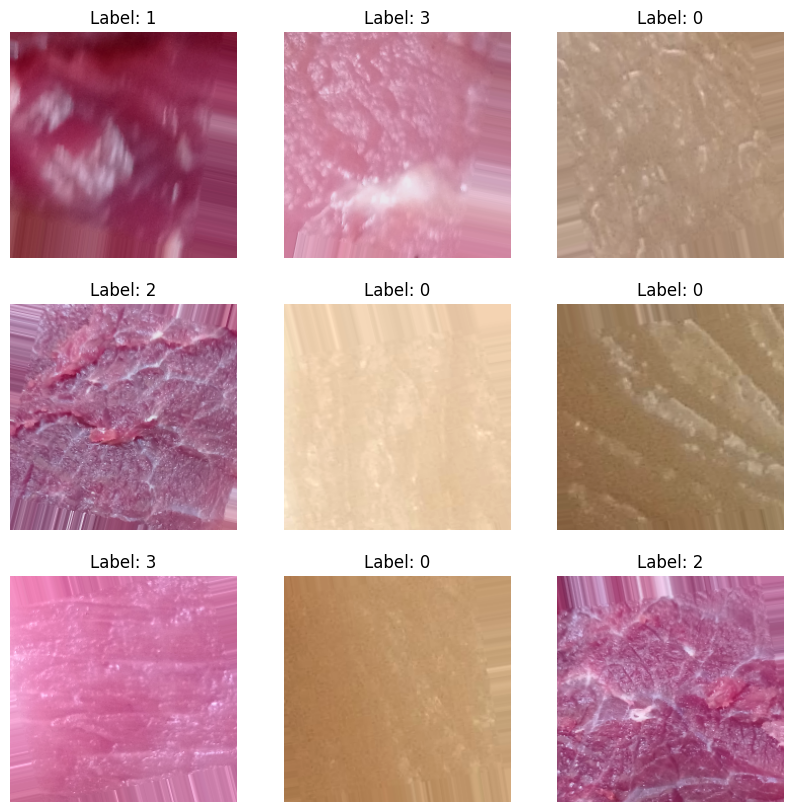

In [ ]:

sample_batch = next(train_generator)
sample_images = sample_batch[0]
sample_labels = sample_batch[1]
print(f"Bentuk batch gambar: {sample_images.shape}")
print(f"Nilai piksel min/max: {np.min(sample_images)} / {np.max(sample_images)}")
plt.figure(figsize=(10, 10))
for i in range(min(9, sample_images.shape[0])):
    plt.subplot(3, 3, i + 1)
    plt.imshow(sample_images[i])
    plt.title(f"Label: {np.argmax(sample_labels[i])}")
    plt.axis('off')
plt.show()

In [ ]:
print(train_generator.class_indices)

{'Chicken': 0, 'Horse Meat': 1, 'Meat': 2, 'Pork': 3}


In [ ]:
# Clear any previous Keras session to free up memory and prevent naming conflicts
tf.keras.backend.clear_session()

# Load pre-trained ResNet50
base_model = MobileNetV2(
    weights='imagenet',
    include_top=False,
    input_shape=(IMG_SIZE, IMG_SIZE, 3),
    alpha=1.4
)

# Freeze base model initially
base_model.trainable = False

model = keras.Sequential([
    base_model,
    layers.GlobalAveragePooling2D(),
    layers.Dropout(0.5),
    layers.Dense(256, activation='relu', kernel_regularizer=keras.regularizers.l2(0.001)),
    layers.BatchNormalization(),
    layers.Dropout(0.6),
    layers.Dense(128, activation='relu', kernel_regularizer=keras.regularizers.l2(0.001)),
    layers.BatchNormalization(),
    layers.Dropout(0.5),
    layers.Dense(num_classes, activation='softmax', name='predictions')
])

# Anda sekarang memiliki model yang siap untuk dikompilasi dan dilatih
# Contoh kompilasi model (Anda dapat menyesuaikan optimizer dan metrik)
model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=LEARNING_RATE),
              loss='categorical_crossentropy',
              metrics=['accuracy'])
model.summary()

17831080/17831080 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ mobilenetv2_1.40_224            │ (None, 7, 7, 1792)     │     4,363,712 │
│ (Functional)                    │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling2d        │ (None, 1792)           │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 1792)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 256)            │       459,008 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 256)            │         1,024 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 256)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 128)            │        32,896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (None, 128)            │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_2 (Dropout)             │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ predictions (Dense)             │ (None, 4)              │           516 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,857,668 (18.53 MB)

 Trainable params: 493,188 (1.88 MB)

 Non-trainable params: 4,364,480 (16.65 MB)

In [ ]:

 # Early stopping for validation accuracy
early_stopping = EarlyStopping(
     monitor='val_accuracy',
     patience=10,
     restore_best_weights=True,
     verbose=1,
     mode='max'
 )

 # More aggressive learning rate reduction
reduce_lr = ReduceLROnPlateau(
     monitor='val_loss',
     factor=0.3,  # More aggressive reduction
     patience=3,  # Shorter patience
     min_lr=1e-8,
     verbose=1,
     mode='min'
 )

 # Model checkpoint based on validation loss
checkpoint = ModelCheckpoint(
     '/content/best_meat_model.keras',
     monitor='val_loss',
     save_best_only=True,
     save_weights_only=False,
     verbose=1,
     mode='min'
 )

callbacks=[early_stopping, reduce_lr, checkpoint]

In [ ]:
history1 = model.fit(
     train_generator,
     epochs=EPOCHS,
     validation_data=validation_generator,
     callbacks=callbacks,
     verbose=1
 )

/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/50
13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - accuracy: 0.3497 - loss: 2.7237
Epoch 1: val_loss improved from inf to 1.61970, saving model to /content/best_meat_model.keras
13/13 ━━━━━━━━━━━━━━━━━━━━ 36s 2s/step - accuracy: 0.3521 - loss: 2.7128 - val_accuracy: 0.4894 - val_loss: 1.6197 - learning_rate: 5.0000e-04
Epoch 2/50
13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 803ms/step - accuracy: 0.4467 - loss: 2.1321
Epoch 2: val_loss improved from 1.61970 to 1.35718, saving model to /content/best_meat_model.keras
13/13 ━━━━━━━━━━━━━━━━━━━━ 11s 899ms/step - accuracy: 0.4509 - loss: 2.1187 - val_accuracy: 0.6809 - val_loss: 1.3572 - learning_rate: 5.0000e-04
Epoch 3/50
13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 744ms/step - accuracy: 0.6340 - loss: 1.6079
Epoch 3: val_loss improved from 1.35718 to 1.20169, saving model to /content/best_meat_model.keras
13/13 ━━━━━━━━━━━━━━━━━━━━ 11s 839ms/step - accuracy: 0.6364 - loss: 1.6000 - val_accuracy: 0.7660 - val_loss: 1.2017 - learning_rate: 5.0000e-04
Epoch 4/50
13/13 

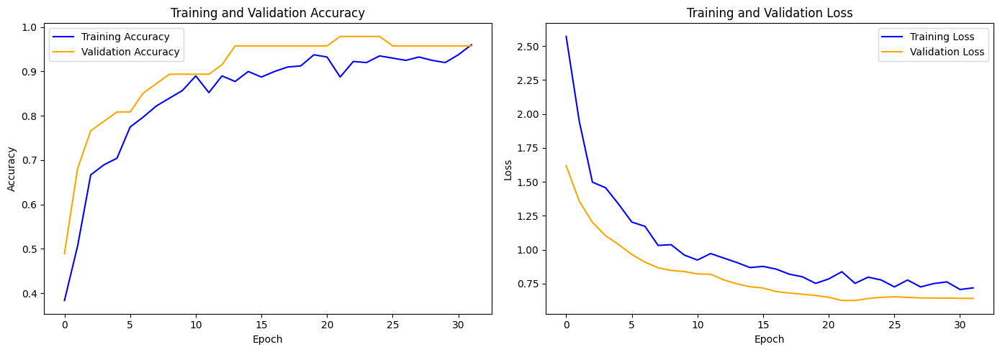

In [ ]:
acc = history1.history['accuracy']
val_acc = history1.history['val_accuracy']
loss = history1.history['loss']
val_loss = history1.history['val_loss']
epochs_range = range(len(acc))

plt.figure(figsize=(14, 5))

# Accuracy
plt.subplot(1, 2, 1)
plt.plot(epochs_range, acc, label='Training Accuracy', color='blue')
plt.plot(epochs_range, val_acc, label='Validation Accuracy', color='orange')
plt.title('Training and Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()

# Loss
plt.subplot(1, 2, 2)
plt.plot(epochs_range, loss, label='Training Loss', color='blue')
plt.plot(epochs_range, val_loss, label='Validation Loss', color='orange')
plt.title('Training and Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()

plt.tight_layout()
plt.show()



MODEL EVALUATION
2/2 ━━━━━━━━━━━━━━━━━━━━ 5s 5s/step - accuracy: 0.9402 - loss: 0.6800

Test Accuracy: 0.9259
Test Loss: 0.7149
2/2 ━━━━━━━━━━━━━━━━━━━━ 8s 3s/step

Classification Report:
              precision    recall  f1-score   support

     Chicken       0.94      1.00      0.97        15
  Horse Meat       0.86      0.92      0.89        13
        Meat       1.00      1.00      1.00        12
        Pork       0.92      0.79      0.85        14

    accuracy                           0.93        54
   macro avg       0.93      0.93      0.93        54
weighted avg       0.93      0.93      0.92        54



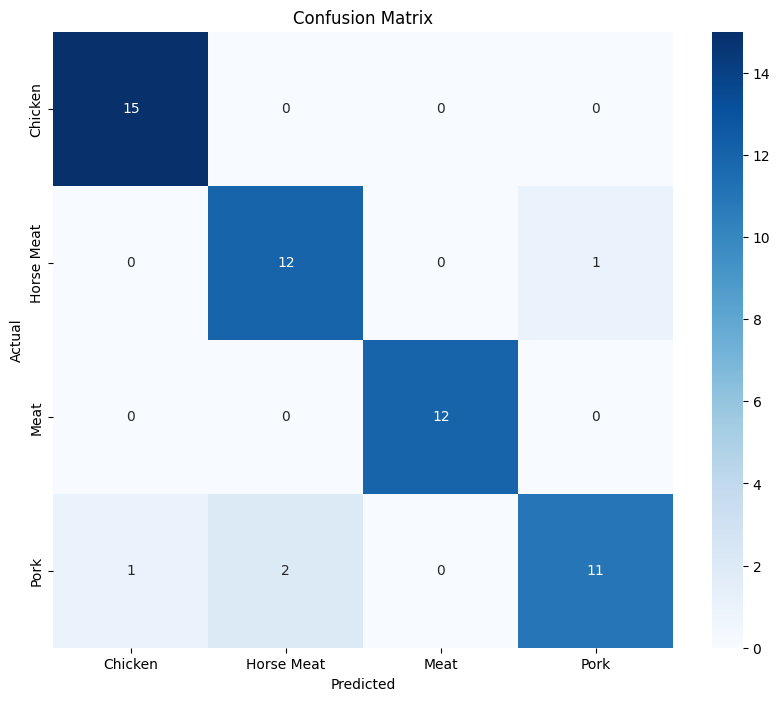

(0.9259259104728699, 0.7149096131324768)

In [ ]:
# Plot Accuracy & Loss
acc = history1.history['accuracy']
val_acc = history1.history['val_accuracy']
loss = history1.history['loss']
val_loss = history1.history['val_loss']
epochs_range = range(len(acc))

plt.figure(figsize=(14, 5))

# Accuracy
plt.subplot(1, 2, 1)
plt.plot(epochs_range, acc, label='Train Accuracy')
plt.plot(epochs_range, val_acc, label='Val Accuracy')
plt.title('📈 Accuracy per Epoch')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()

# Loss
plt.subplot(1, 2, 2)
plt.plot(epochs_range, loss, label='Train Loss')
plt.plot(epochs_range, val_loss, label='Val Loss')
plt.title('📉 Loss per Epoch')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()

plt.tight_layout()
plt.show()


In [185]:
import os
import numpy as np
import matplotlib.pyplot as plt
from tensorflow import keras

# Assuming these are defined globally or passed as parameters
# If not, you'll need to define them or adjust the function signature
IMG_SIZE = 224  # Example size, replace with your actual IMG_SIZE
CLASS_NAMES = ['Chicken', 'Horse Meat', 'Meat', 'Pork'] # Example, replace with your actual CLASS_NAMES

def predict_multiple_images(model, base_test_dir):
    """
    Predicts the class of multiple images organized in subfolders within a base directory.

    Args:
        model: The trained Keras model for prediction.
        base_test_dir (str): The path to the base directory containing the test subfolders
                             (e.g., 'path/to/your/Jenis Daging/test').
    Returns:
        dict: A dictionary where keys are image paths and values are tuples of
              (predicted_class, confidence).
    """
    all_predictions = {}

    # Iterate through each subfolder (class) in the base test directory
    for class_name in os.listdir(base_test_dir):
        class_dir = os.path.join(base_test_dir, class_name)

        # Ensure it's a directory
        if os.path.isdir(class_dir):
            print(f"\n--- Predicting images in folder: {class_name} ---")
            # Iterate through each image file in the current class folder
            for image_filename in os.listdir(class_dir):
                image_path = os.path.join(class_dir, image_filename)

                # Check if it's a file and a common image extension (you might want to expand this)
                if os.path.isfile(image_path) and image_filename.lower().endswith(('.png', '.jpg', '.jpeg', '.gif', '.bmp')):
                    print(f"Predicting: {image_path}")
                    try:
                        # Load and preprocess image
                        img = keras.preprocessing.image.load_img(image_path, target_size=(IMG_SIZE, IMG_SIZE))
                        img_array = keras.preprocessing.image.img_to_array(img)
                        img_array = np.expand_dims(img_array, axis=0)
                        img_array /= 255.0  # Normalize to [0, 1]

                        # Make prediction
                        predictions = model.predict(img_array)
                        predicted_class_index = np.argmax(predictions[0])
                        predicted_class = CLASS_NAMES[predicted_class_index]
                        confidence = np.max(predictions[0])

                        # Store results
                        all_predictions[image_path] = (predicted_class, confidence)

                        # Display results (optional, you might want to remove this for large datasets)
                        plt.figure(figsize=(8, 6))
                        plt.imshow(img)
                        plt.title(f'True: {class_name}, Predicted: {predicted_class} (Confidence: {confidence:.4f})')
                        plt.axis('off')
                        plt.show()

                    except Exception as e:
                        print(f"Error processing {image_path}: {e}")
                else:
                    print(f"Skipping non-image file: {image_path}")
        else:
            print(f"Skipping non-directory item: {class_dir}")

    return all_predictions


# 2. Define your base test directory
# This should point to the 'test' folder that contains 'Chicken', 'Horse Meat', etc.
# For example, if your structure is 'your_project/Jenis Daging/test/'


# 3. Call the function


# You can then print or process the results
# for image_path, (predicted_class, confidence) in results.items():
#     print(f"Image: {image_path}, Predicted: {predicted_class}, Confidence: {confidence:.4f}")


--- Predicting images in folder: Meat ---
Predicting: /content/Jenis Daging/test/Meat/IMG_20220107_083227.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 5s 5s/step


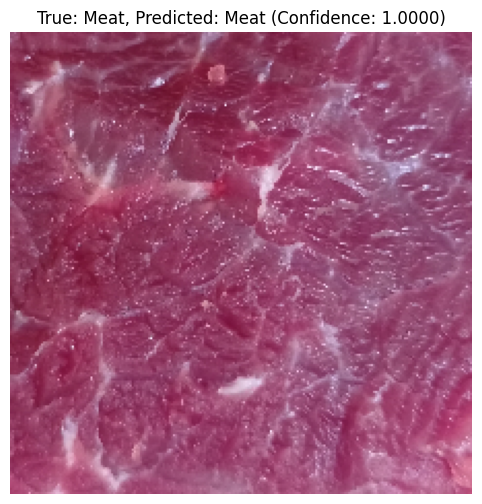

Predicting: /content/Jenis Daging/test/Meat/IMG_20220107_083242.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


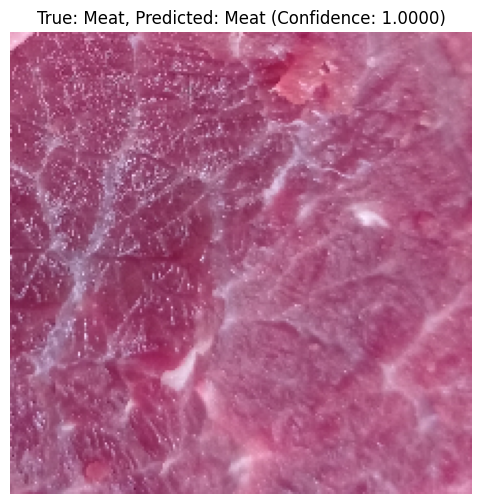

Predicting: /content/Jenis Daging/test/Meat/IMG_20220107_080935.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


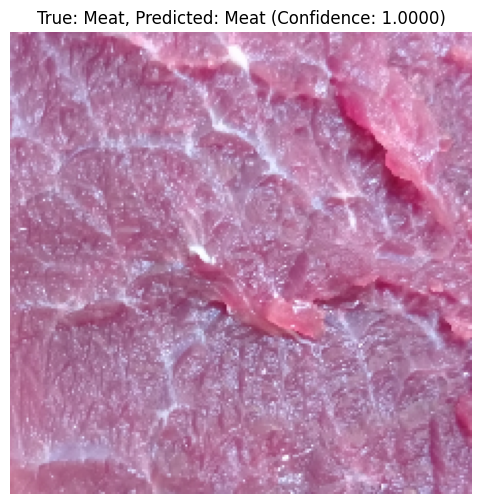

Predicting: /content/Jenis Daging/test/Meat/IMG_20220107_083513.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step


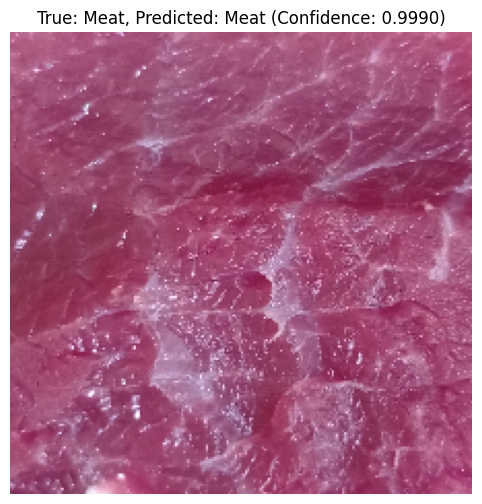

Predicting: /content/Jenis Daging/test/Meat/IMG_20220107_083426.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step


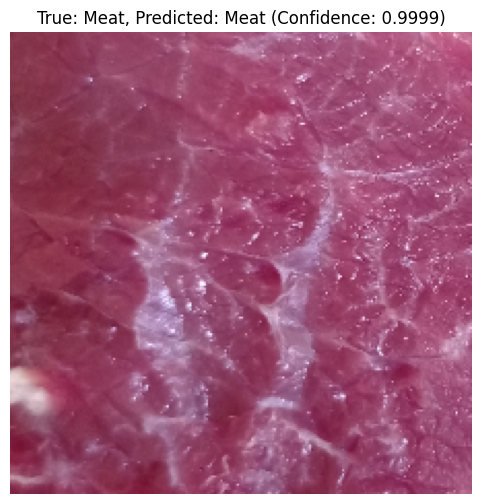

Predicting: /content/Jenis Daging/test/Meat/IMG_20220107_083508.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step


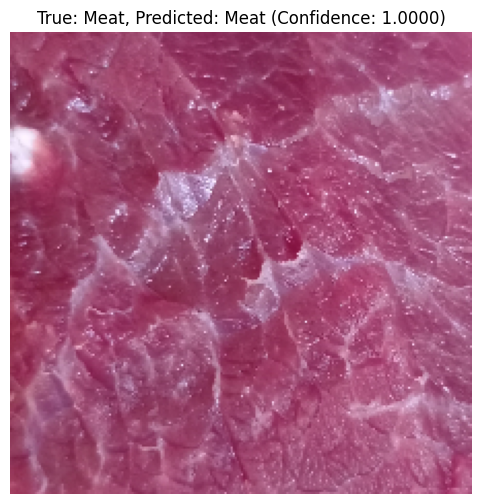

Predicting: /content/Jenis Daging/test/Meat/IMG_20220107_083348.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step


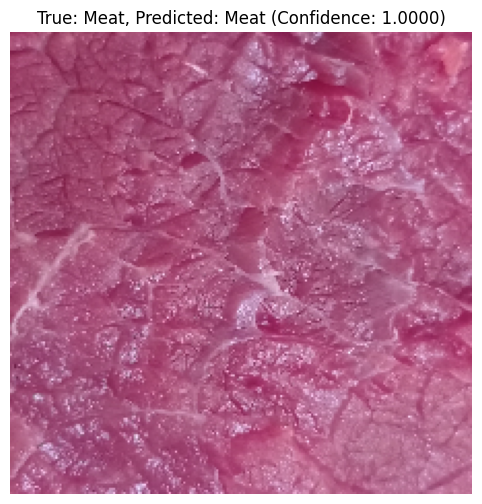

Predicting: /content/Jenis Daging/test/Meat/IMG_20220107_081750.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step


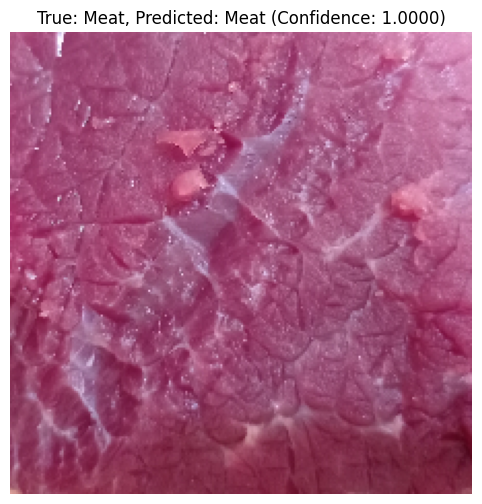

Predicting: /content/Jenis Daging/test/Meat/IMG_20220107_083251.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step


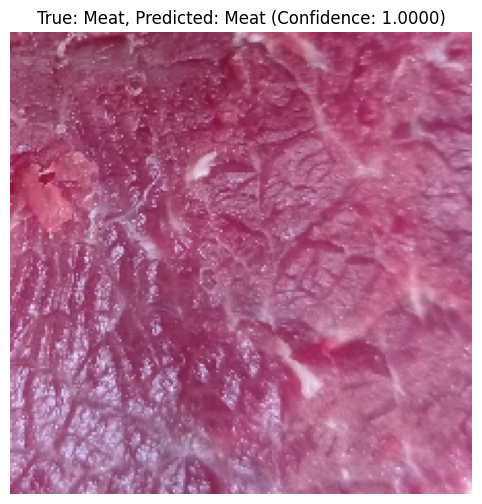

Predicting: /content/Jenis Daging/test/Meat/IMG_20220107_083302.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step


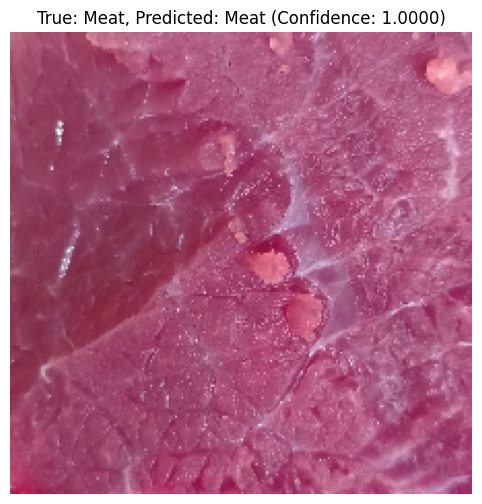

Predicting: /content/Jenis Daging/test/Meat/IMG_20220107_081811.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step


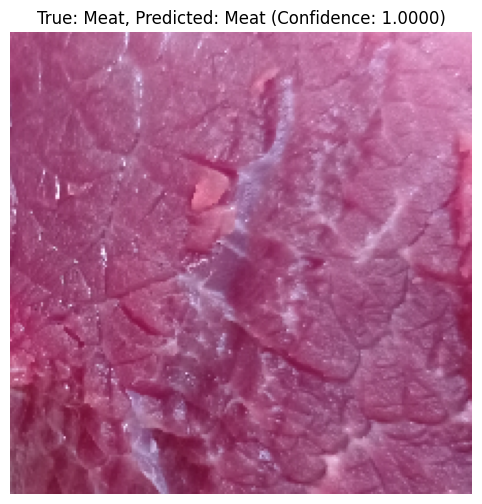

Predicting: /content/Jenis Daging/test/Meat/IMG_20220107_082650.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step


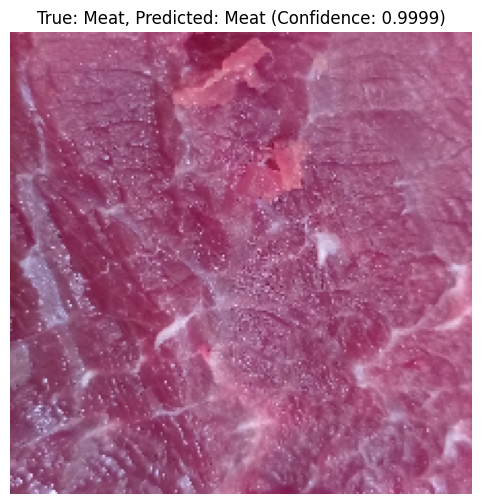


--- Predicting images in folder: Horse Meat ---
Predicting: /content/Jenis Daging/test/Horse Meat/IMG_20220110_105958.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step


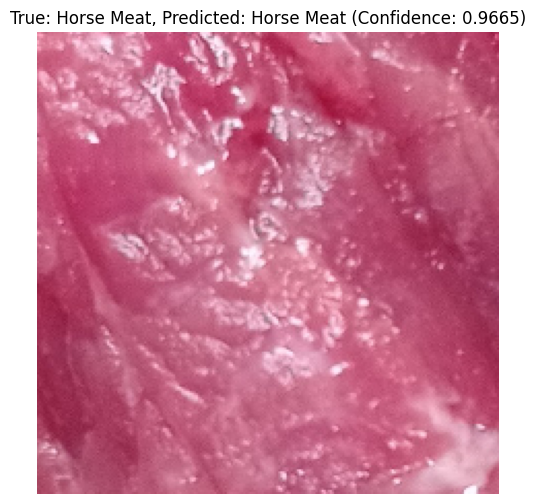

Predicting: /content/Jenis Daging/test/Horse Meat/IMG_20220110_110158.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


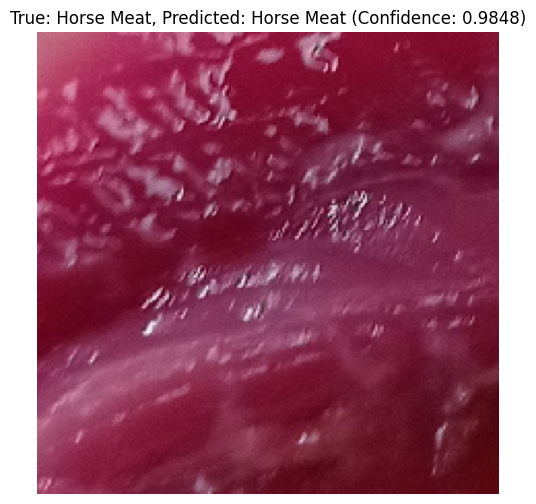

Predicting: /content/Jenis Daging/test/Horse Meat/IMG_20220110_110444.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step


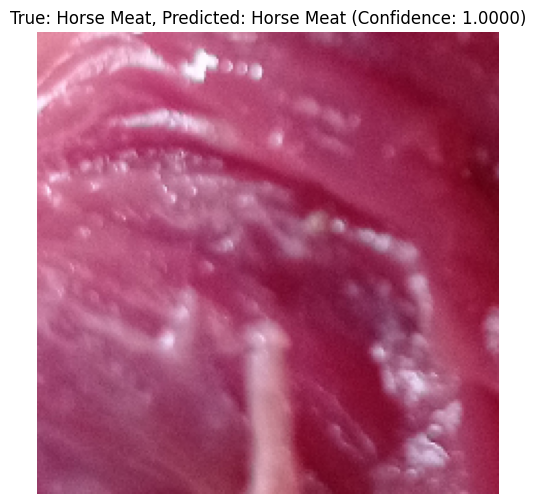

Predicting: /content/Jenis Daging/test/Horse Meat/IMG_20220110_110450.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step


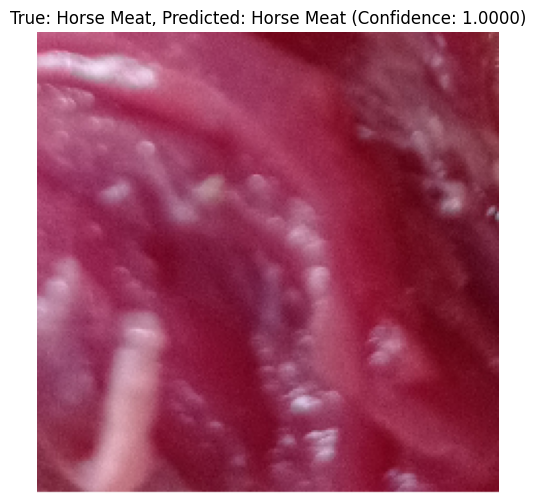

Predicting: /content/Jenis Daging/test/Horse Meat/IMG_20220110_110118.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


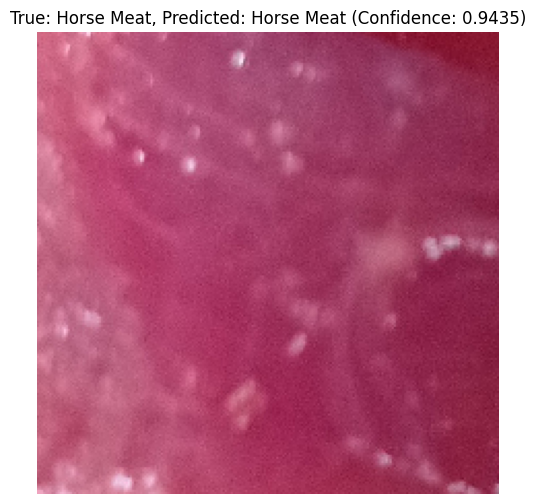

Predicting: /content/Jenis Daging/test/Horse Meat/IMG_20220110_105956.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step


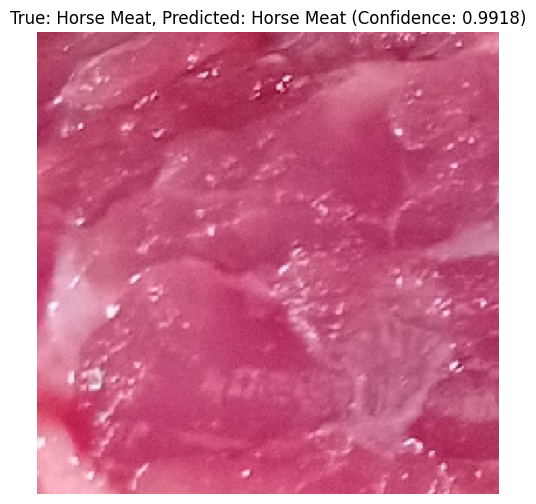

Predicting: /content/Jenis Daging/test/Horse Meat/IMG_20220110_110427.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step


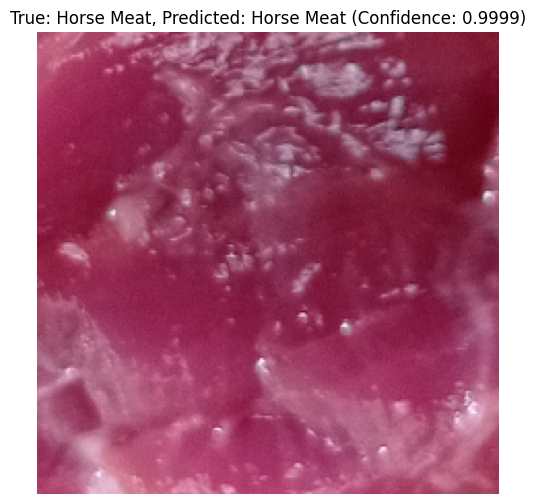

Predicting: /content/Jenis Daging/test/Horse Meat/IMG_20220110_110405.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


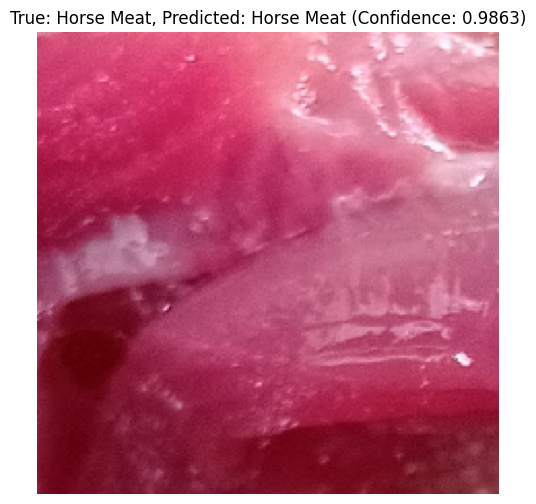

Predicting: /content/Jenis Daging/test/Horse Meat/IMG_20220110_110257.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step


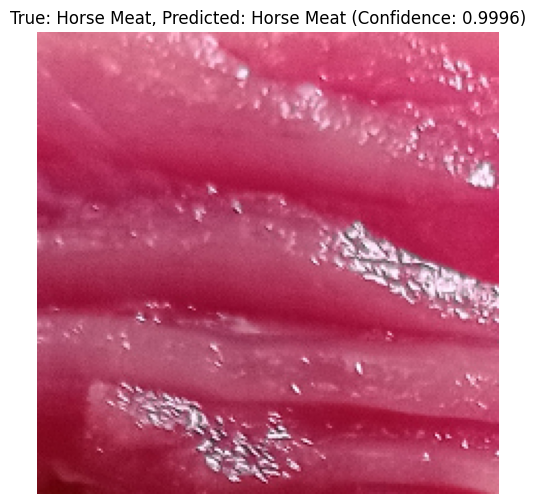

Predicting: /content/Jenis Daging/test/Horse Meat/IMG_20220110_110026.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step


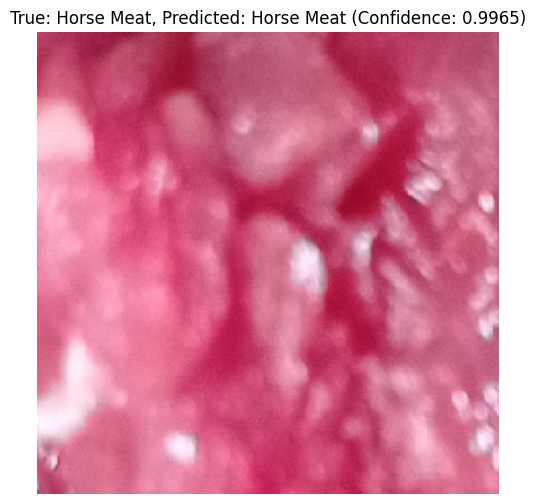

Predicting: /content/Jenis Daging/test/Horse Meat/IMG_20220110_110219.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step


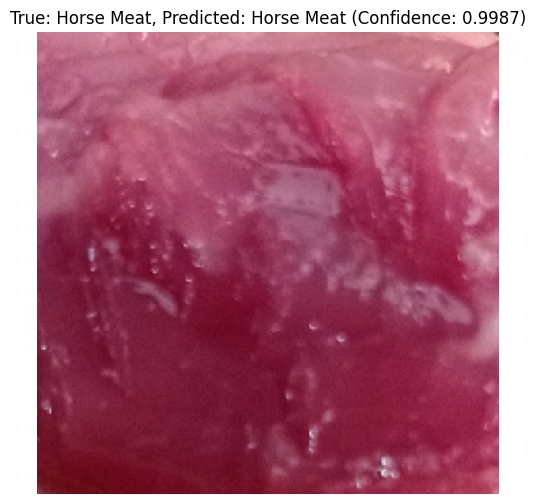

Predicting: /content/Jenis Daging/test/Horse Meat/IMG_20220110_110004.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step


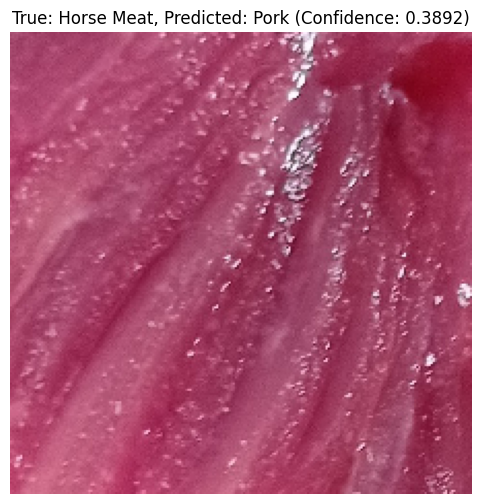

Predicting: /content/Jenis Daging/test/Horse Meat/IMG_20220110_110433.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step


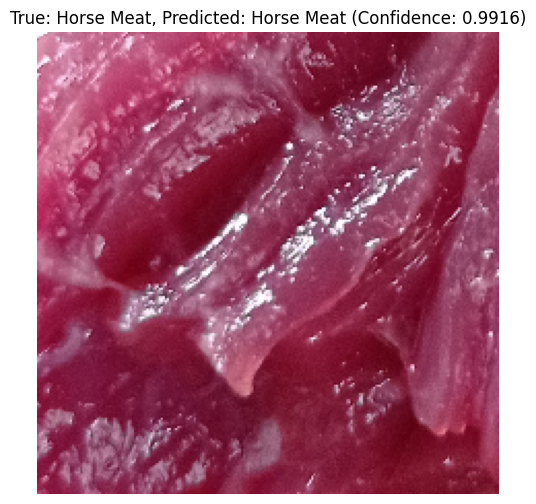


--- Predicting images in folder: Pork ---
Predicting: /content/Jenis Daging/test/Pork/IMG_20220110_094327.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step


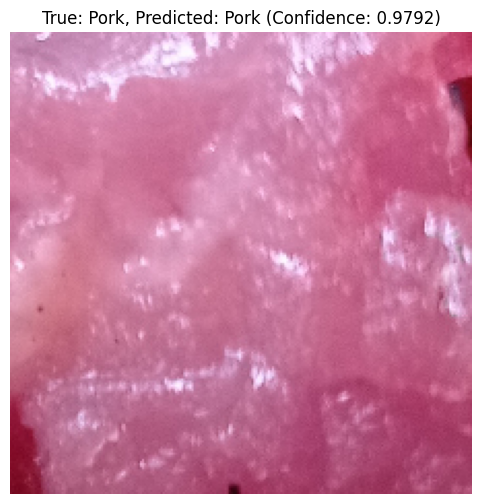

Predicting: /content/Jenis Daging/test/Pork/IMG_20220110_093540.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step


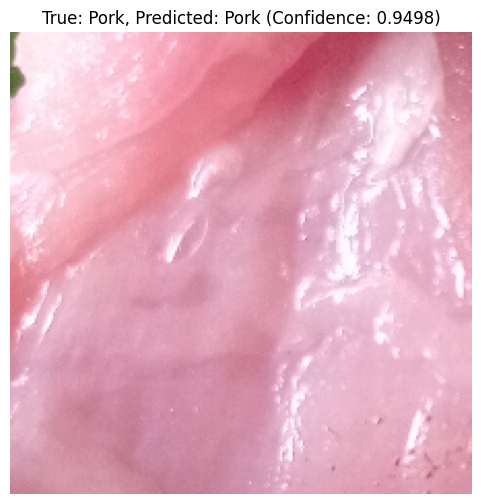

Predicting: /content/Jenis Daging/test/Pork/IMG_20220110_093425.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step


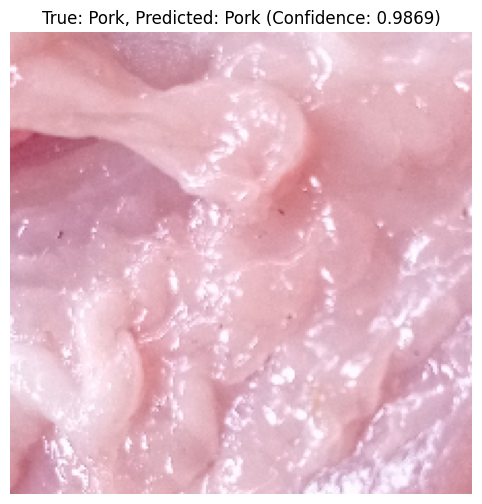

Predicting: /content/Jenis Daging/test/Pork/IMG_20220110_093143.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step


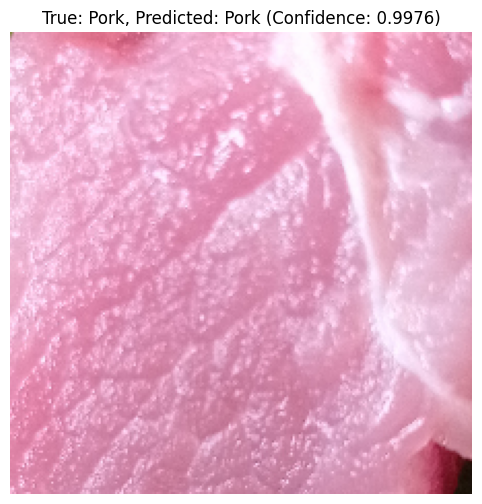

Predicting: /content/Jenis Daging/test/Pork/IMG_20220110_094532.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step


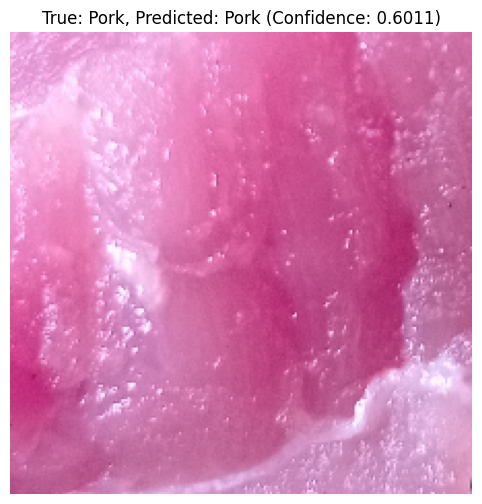

Predicting: /content/Jenis Daging/test/Pork/IMG_20220110_093406.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


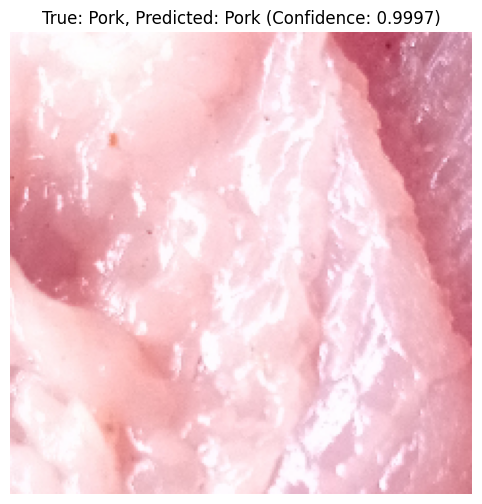

Predicting: /content/Jenis Daging/test/Pork/IMG_20220110_093457.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


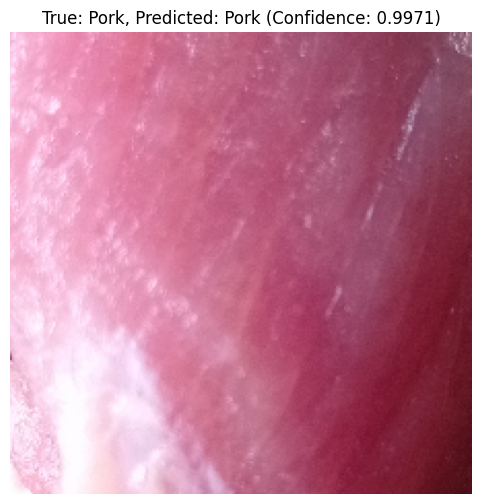

Predicting: /content/Jenis Daging/test/Pork/IMG_20220110_093351.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


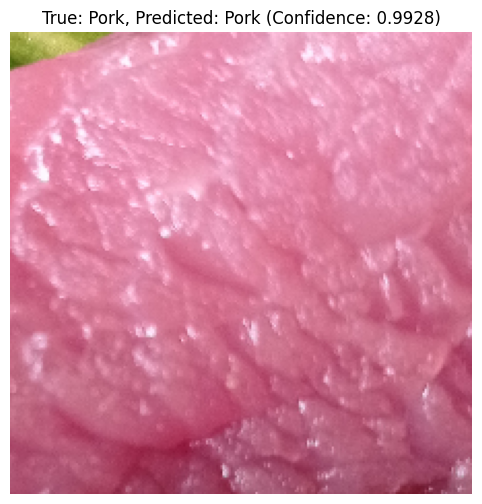

Predicting: /content/Jenis Daging/test/Pork/IMG_20220110_094740.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step


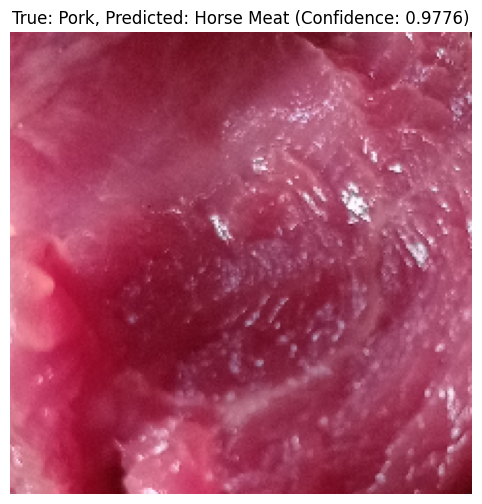

Predicting: /content/Jenis Daging/test/Pork/IMG_20220110_094316.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


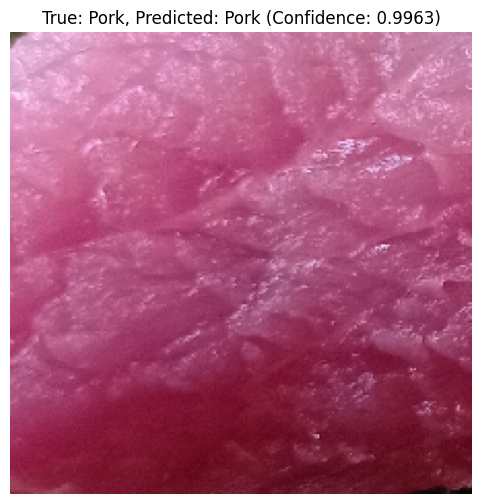

Predicting: /content/Jenis Daging/test/Pork/IMG_20220110_093152.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


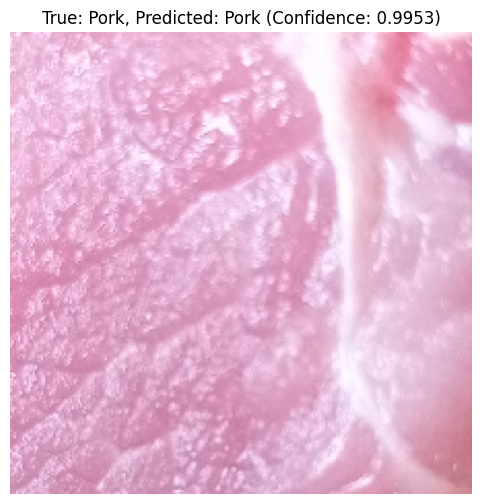

Predicting: /content/Jenis Daging/test/Pork/IMG_20220110_094658.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


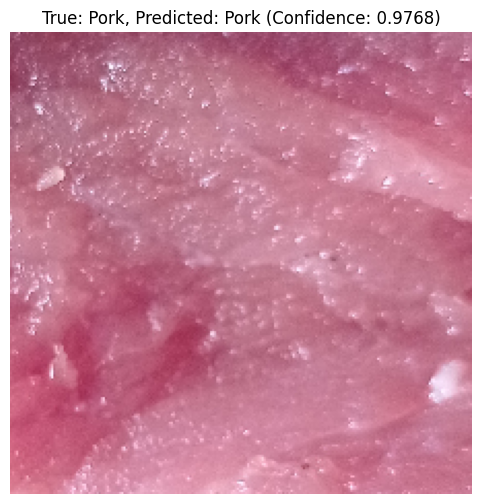

Predicting: /content/Jenis Daging/test/Pork/IMG_20220110_094402.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


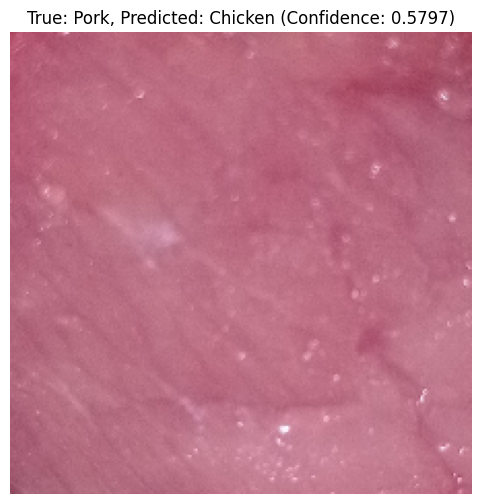

Predicting: /content/Jenis Daging/test/Pork/IMG_20220110_094155.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


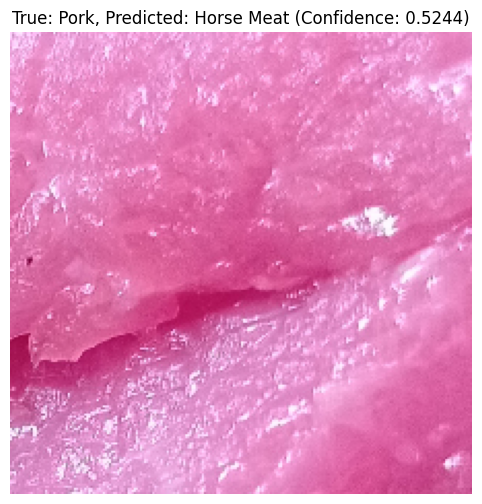


--- Predicting images in folder: Chicken ---
Predicting: /content/Jenis Daging/test/Chicken/segar_0017_jpg.rf.53f107e77a9e9d1c9229add21b3c6c9e.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


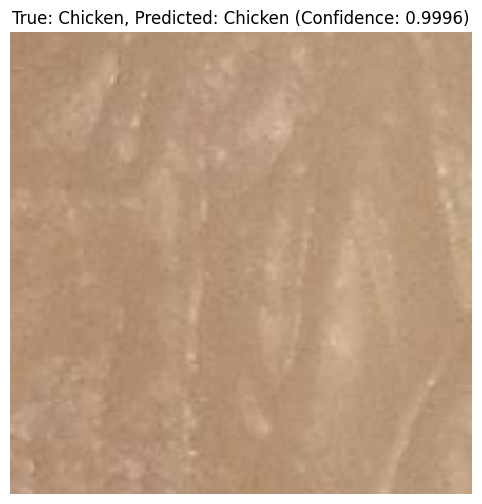

Predicting: /content/Jenis Daging/test/Chicken/segar_0010_jpg.rf.9d564290f4de8f56a0b4b75520ae4bc8.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


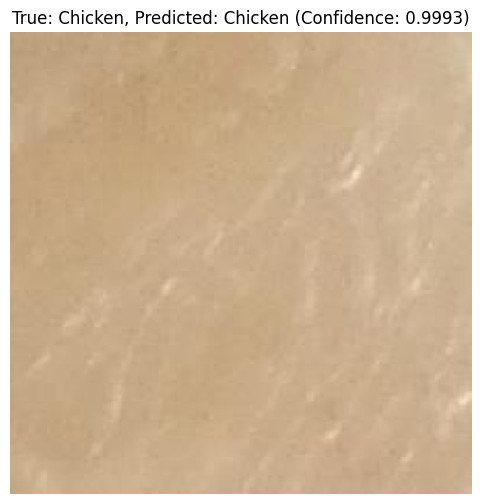

Predicting: /content/Jenis Daging/test/Chicken/segar_0021_jpg.rf.613604ec96395fd9b5f05946636eb461.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


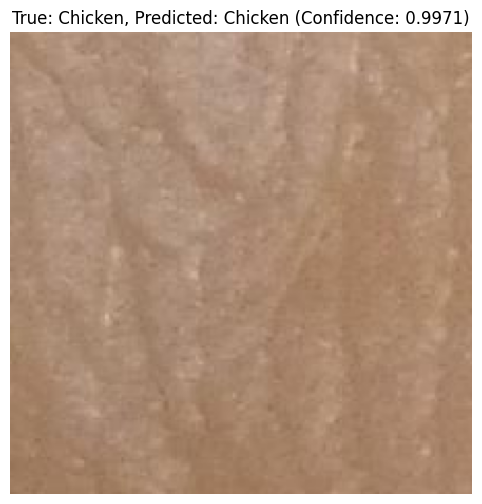

Predicting: /content/Jenis Daging/test/Chicken/segar_0020_jpg.rf.8c65321ff1eb2b4769ec4e61a2402b94.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


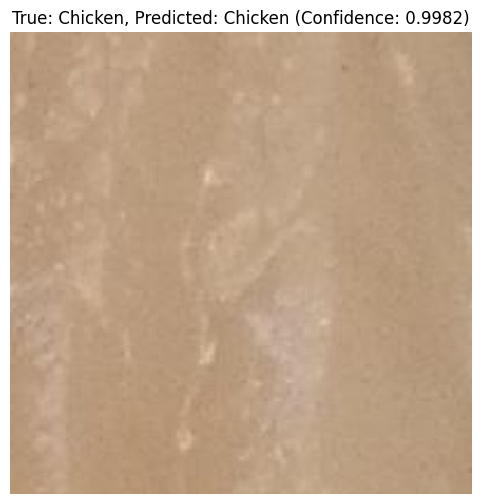

Predicting: /content/Jenis Daging/test/Chicken/segar_0006_jpg.rf.2b12e3ca3e3b28eeec14e171bab5f8be.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


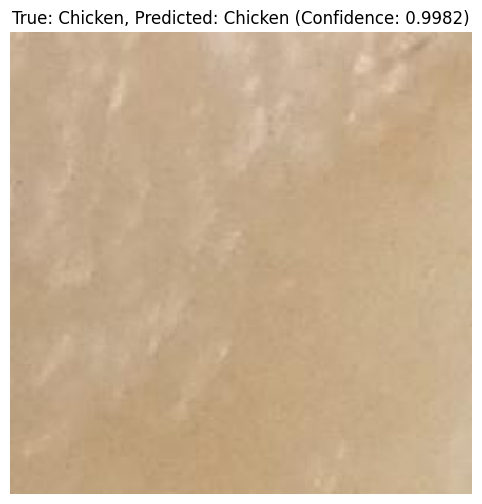

Predicting: /content/Jenis Daging/test/Chicken/segar_0015_jpg.rf.e5e2cb3459ffbe321cab291159c4a4c0.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step


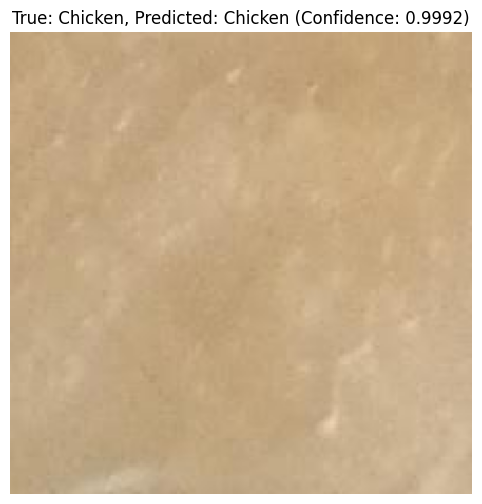

Predicting: /content/Jenis Daging/test/Chicken/segar_0002_jpg.rf.6a36c3f3000a35d008a15d9175c7dbf2.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step


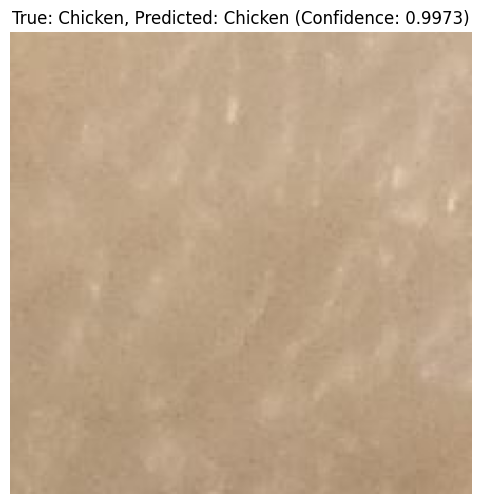

Predicting: /content/Jenis Daging/test/Chicken/segar_0016_jpg.rf.acc94ed1093f5b5096c0cbfb271b783f.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step


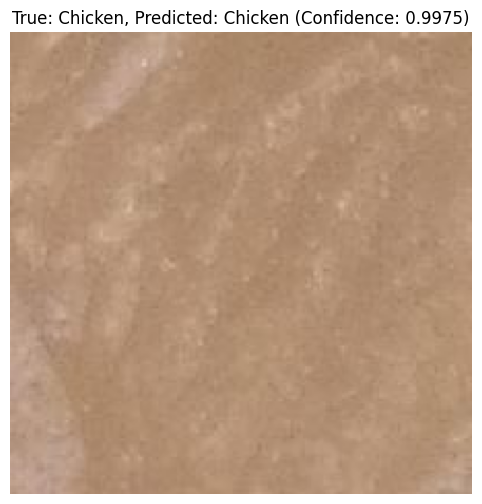

Predicting: /content/Jenis Daging/test/Chicken/segar_0011_jpg.rf.e3ce3b718334cbfb0de6f50317dcbfae.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step


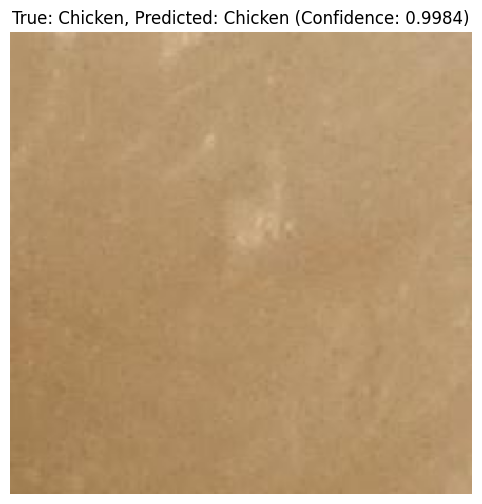

Predicting: /content/Jenis Daging/test/Chicken/segar_0022_jpg.rf.0d274ed22d5d88530538a65025ef507a.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step


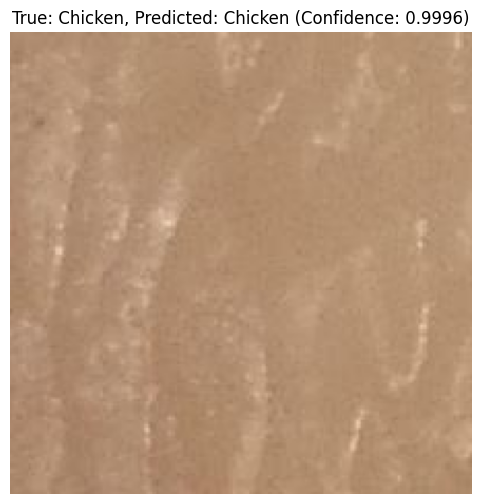

Predicting: /content/Jenis Daging/test/Chicken/segar_0007_jpg.rf.95121e5360a259e5e94a6c47ac9fa380.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


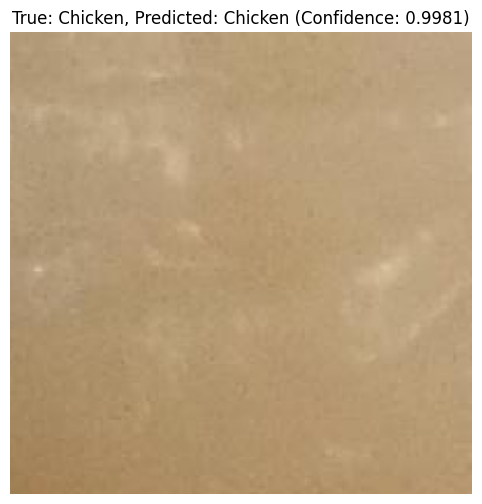

Predicting: /content/Jenis Daging/test/Chicken/segar_0001_jpg.rf.2b7c7688b49f27570b790639a49077a0.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step


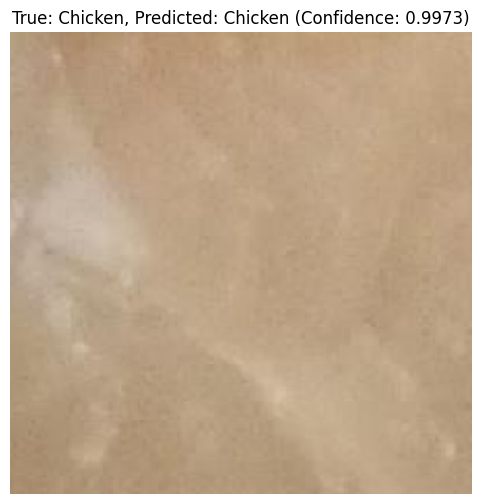

Predicting: /content/Jenis Daging/test/Chicken/segar_0012_jpg.rf.60716678c083f901ce955aae65d6d5a3.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step


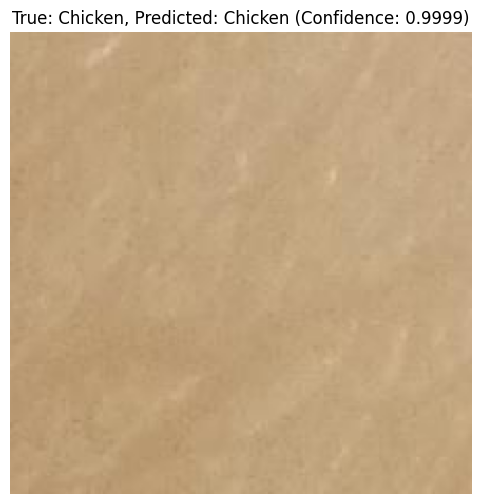

Predicting: /content/Jenis Daging/test/Chicken/segar_0008_jpg.rf.ba6330e175bd6155776e96ab15ea4def.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step


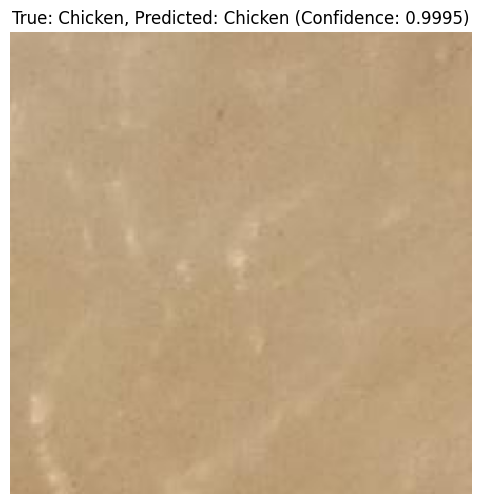

Predicting: /content/Jenis Daging/test/Chicken/segar_0003_jpg.rf.d9d9f18228956e2c55716cfdfec46d3d.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


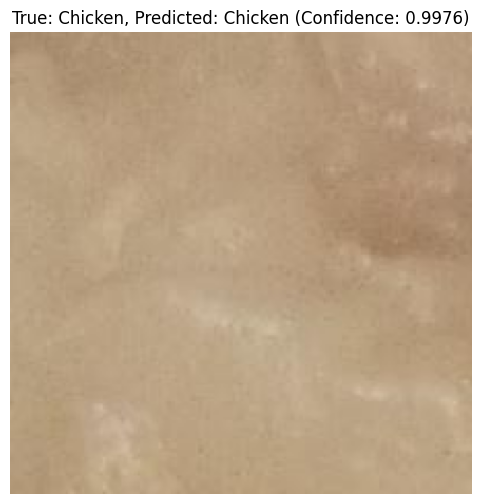

In [ ]:
# Load trained model
model = keras.models.load_model('/content/best_meat_model.keras')

# Predict single image

results = predict_multiple_images(model, TEST_PATH)


In [176]:
fine_tune_at = 100
FINE_TUNE_EPOCHS = 15
FINE_TUNE_LR = 1e-5


In [177]:
fine_tune_checkpoint = ModelCheckpoint(
     '/content/fine_tuned_meat_model.keras',  # beda file
     monitor='val_loss',
     save_best_only=True,
     save_weights_only=False,
     verbose=1,
     mode='min'
)

fine_tune_callbacks = [early_stopping, reduce_lr, fine_tune_checkpoint]

In [178]:
# 1. Buka sebagian besar layer (misalnya 50 layer terakhir)
base_model.trainable = True

for layer in base_model.layers[:fine_tune_at]:
    layer.trainable = False

# 2. Compile ulang model dengan learning rate lebih kecil
model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=FINE_TUNE_LR),
              loss='categorical_crossentropy',
              metrics=['accuracy'])



In [179]:
fine_tune_history = model.fit(
    train_generator,
    epochs=EPOCHS + FINE_TUNE_EPOCHS,
    initial_epoch=history1.epoch[-1] + 1,
    validation_data=validation_generator,
    callbacks=fine_tune_callbacks,
    verbose=1
)


Epoch 33/65
13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 994ms/step - accuracy: 0.9230 - loss: 0.7602
Epoch 33: val_loss improved from inf to 0.62469, saving model to /content/fine_tuned_meat_model.keras
13/13 ━━━━━━━━━━━━━━━━━━━━ 33s 2s/step - accuracy: 0.9229 - loss: 0.7598 - val_accuracy: 0.9787 - val_loss: 0.6247 - learning_rate: 1.0000e-05
Epoch 34/65
13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 620ms/step - accuracy: 0.9123 - loss: 0.8153
Epoch 34: val_loss did not improve from 0.62469
13/13 ━━━━━━━━━━━━━━━━━━━━ 9s 664ms/step - accuracy: 0.9138 - loss: 0.8129 - val_accuracy: 0.9787 - val_loss: 0.6251 - learning_rate: 1.0000e-05
Epoch 35/65
13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 662ms/step - accuracy: 0.9238 - loss: 0.7786
Epoch 35: val_loss did not improve from 0.62469
13/13 ━━━━━━━━━━━━━━━━━━━━ 11s 706ms/step - accuracy: 0.9224 - loss: 0.7804 - val_accuracy: 0.9787 - val_loss: 0.6254 - learning_rate: 1.0000e-05
Epoch 36/65
13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 752ms/step - accuracy: 0.9023 - loss: 0.7819
Epoch 36: ReduceLROn

In [180]:
def plot_combined_history(initial_history, fine_history):
    acc = initial_history.history['accuracy'] + fine_history.history['accuracy']
    val_acc = initial_history.history['val_accuracy'] + fine_history.history['val_accuracy']
    loss = initial_history.history['loss'] + fine_history.history['loss']
    val_loss = initial_history.history['val_loss'] + fine_history.history['val_loss']
    epochs_range = range(len(acc))

    plt.figure(figsize=(14, 5))

    # Accuracy
    plt.subplot(1, 2, 1)
    plt.plot(epochs_range, acc, label='Train Accuracy', color='blue')
    plt.plot(epochs_range, val_acc, label='Validation Accuracy', color='orange')
    plt.axvline(x=len(initial_history.history['accuracy']) - 1, color='gray', linestyle='--', label='Fine-tune Start')
    plt.title('Accuracy (Train + Val)')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.legend()

    # Loss
    plt.subplot(1, 2, 2)
    plt.plot(epochs_range, loss, label='Train Loss', color='blue')
    plt.plot(epochs_range, val_loss, label='Validation Loss', color='orange')
    plt.axvline(x=len(initial_history.history['accuracy']) - 1, color='gray', linestyle='--', label='Fine-tune Start')
    plt.title('Loss (Train + Val)')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()

    plt.tight_layout()
    plt.show()


In [182]:
from sklearn.metrics import classification_report, confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

def evaluate_model(model, test_generator, class_names):
    print("\n🔍 Evaluating model on test data...")
    test_loss, test_acc = model.evaluate(test_generator, verbose=1)
    print(f"\n✅ Test Accuracy: {test_acc:.4f}")
    print(f"❌ Test Loss: {test_loss:.4f}")

    # Predict
    test_generator.reset()
    y_prob = model.predict(test_generator)
    y_pred = np.argmax(y_prob, axis=1)
    y_true = test_generator.classes

    # Classification Report
    print("\n📄 Classification Report:")
    print(classification_report(y_true, y_pred, target_names=class_names))

    # Confusion Matrix
    cm = confusion_matrix(y_true, y_pred)
    plt.figure(figsize=(8, 6))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
                xticklabels=class_names,
                yticklabels=class_names)
    plt.title("Confusion Matrix")
    plt.xlabel("Predicted")
    plt.ylabel("Actual")
    plt.show()



🔍 Evaluating model on test data...
2/2 ━━━━━━━━━━━━━━━━━━━━ 13s 2s/step - accuracy: 0.9525 - loss: 0.6711

✅ Test Accuracy: 0.9444
❌ Test Loss: 0.7014
2/2 ━━━━━━━━━━━━━━━━━━━━ 8s 3s/step

📄 Classification Report:
              precision    recall  f1-score   support

     Chicken       0.94      1.00      0.97        15
  Horse Meat       0.92      0.92      0.92        13
        Meat       1.00      1.00      1.00        12
        Pork       0.92      0.86      0.89        14

    accuracy                           0.94        54
   macro avg       0.95      0.95      0.94        54
weighted avg       0.94      0.94      0.94        54



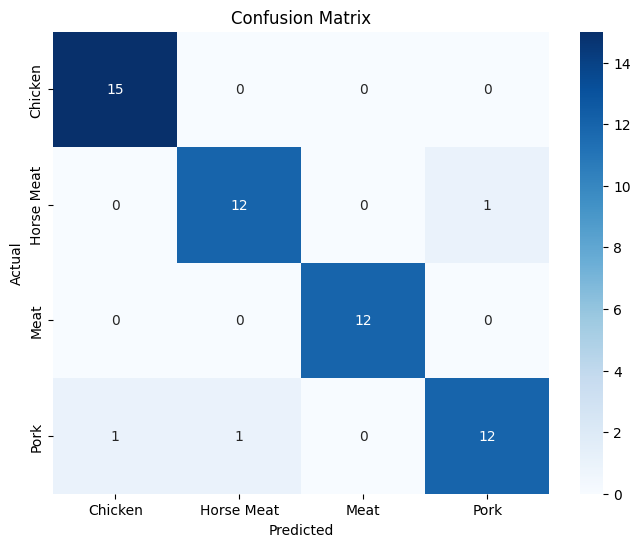

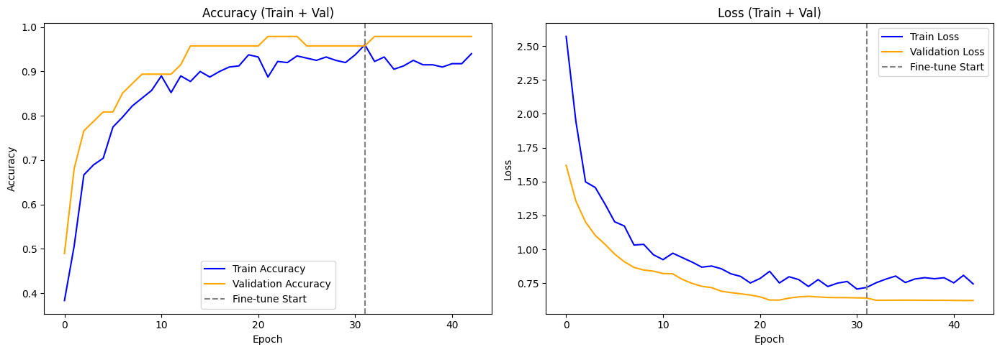

In [183]:
# Optional: Load best fine-tuned model kalau disimpan ke file terpisah
fine_tuned_model = tf.keras.models.load_model('/content/fine_tuned_meat_model.keras')

# 1. Evaluasi model fine-tuned
evaluate_model(fine_tuned_model, test_generator, CLASS_NAMES)

# 2. Tampilkan grafik akurasi + loss dari training awal + fine-tune
plot_combined_history(history1, fine_tune_history)


--- Predicting images in folder: Meat ---
Predicting: /content/Jenis Daging/test/Meat/IMG_20220107_083227.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


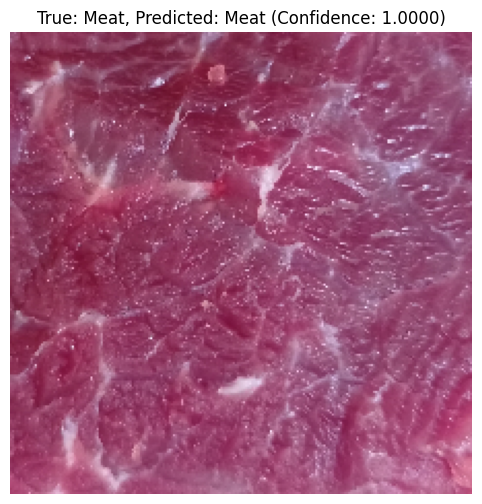

Predicting: /content/Jenis Daging/test/Meat/IMG_20220107_083242.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step


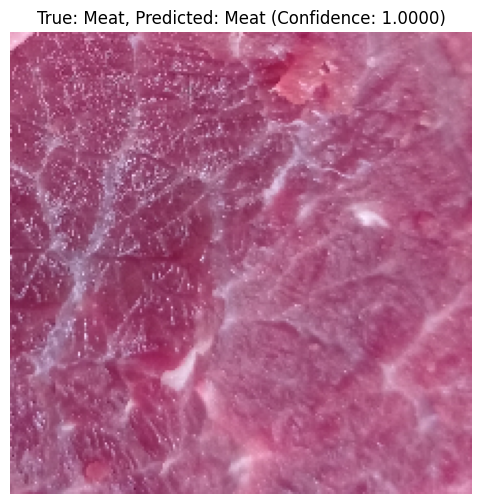

Predicting: /content/Jenis Daging/test/Meat/IMG_20220107_080935.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step


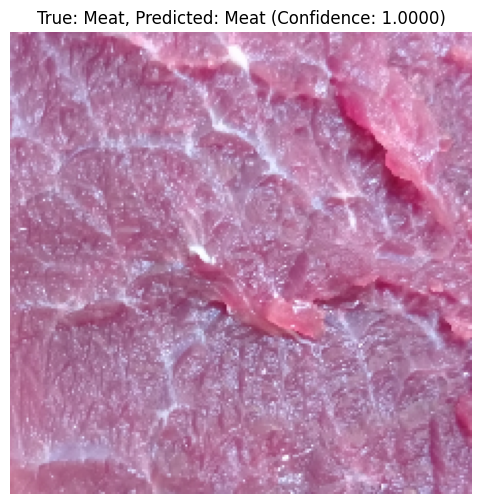

Predicting: /content/Jenis Daging/test/Meat/IMG_20220107_083513.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step


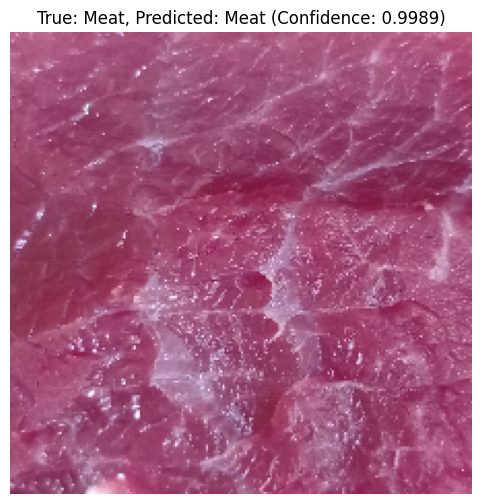

Predicting: /content/Jenis Daging/test/Meat/IMG_20220107_083426.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step


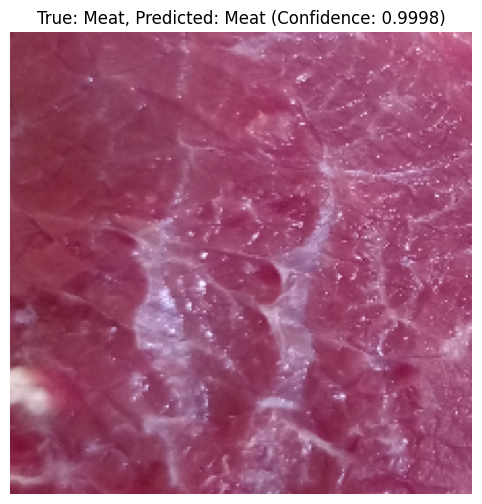

Predicting: /content/Jenis Daging/test/Meat/IMG_20220107_083508.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step


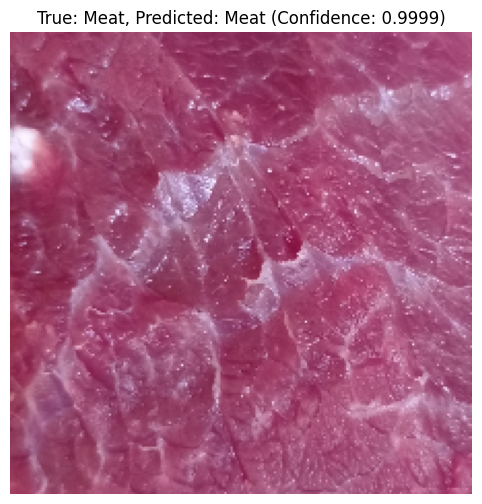

Predicting: /content/Jenis Daging/test/Meat/IMG_20220107_083348.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step


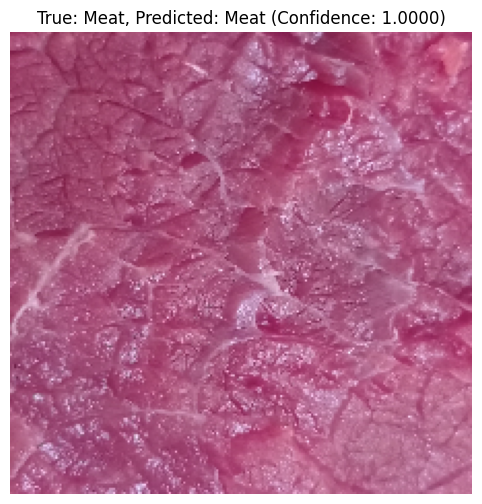

Predicting: /content/Jenis Daging/test/Meat/IMG_20220107_081750.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step


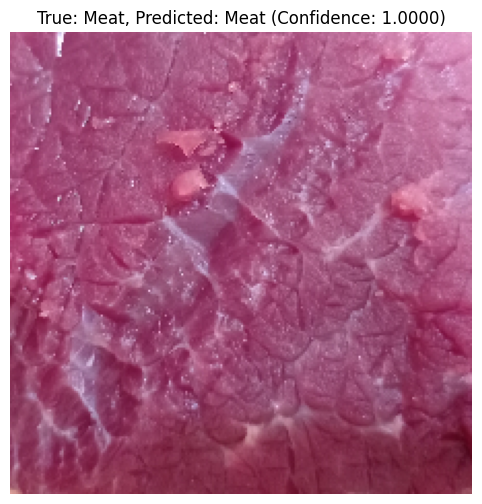

Predicting: /content/Jenis Daging/test/Meat/IMG_20220107_083251.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step


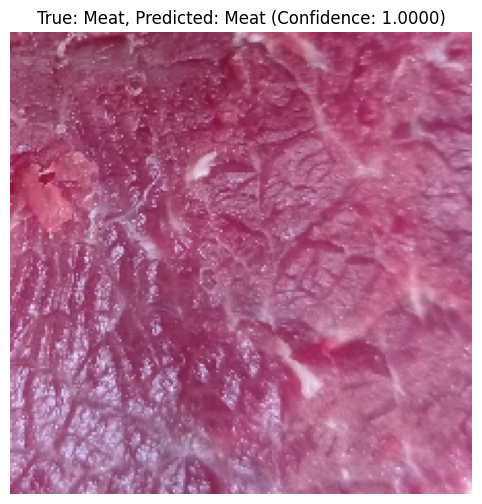

Predicting: /content/Jenis Daging/test/Meat/IMG_20220107_083302.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step


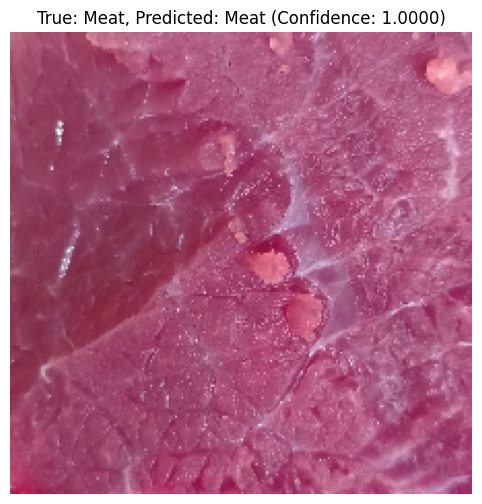

Predicting: /content/Jenis Daging/test/Meat/IMG_20220107_081811.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step


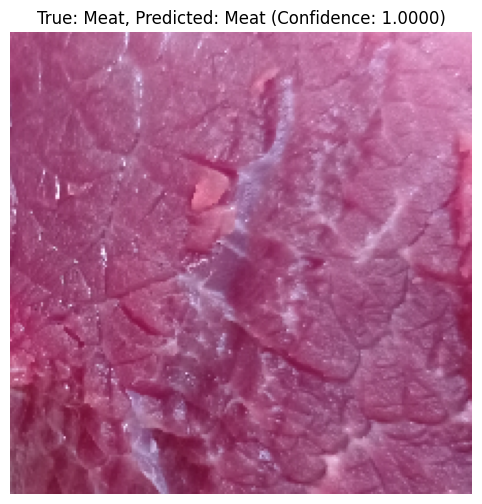

Predicting: /content/Jenis Daging/test/Meat/IMG_20220107_082650.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step


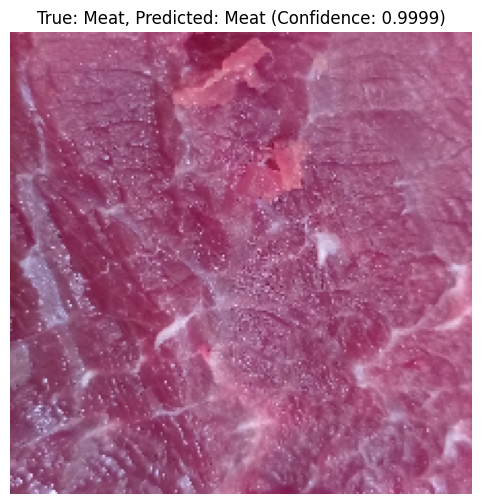


--- Predicting images in folder: Horse Meat ---
Predicting: /content/Jenis Daging/test/Horse Meat/IMG_20220110_105958.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step


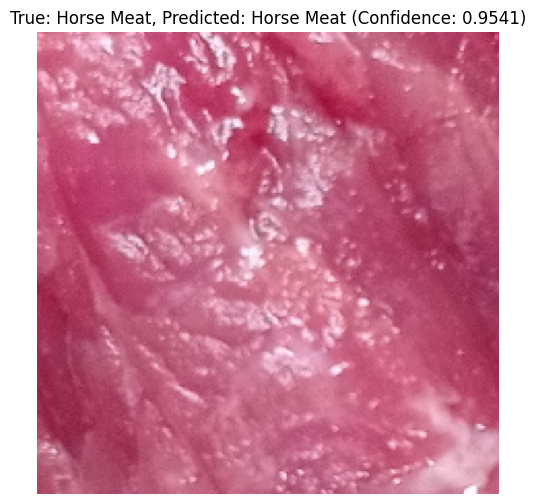

Predicting: /content/Jenis Daging/test/Horse Meat/IMG_20220110_110158.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step


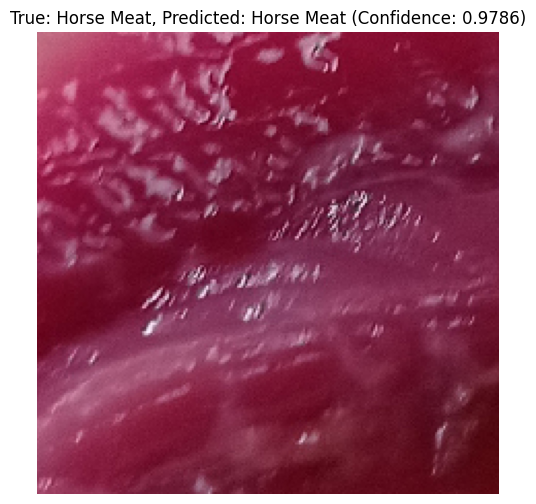

Predicting: /content/Jenis Daging/test/Horse Meat/IMG_20220110_110444.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


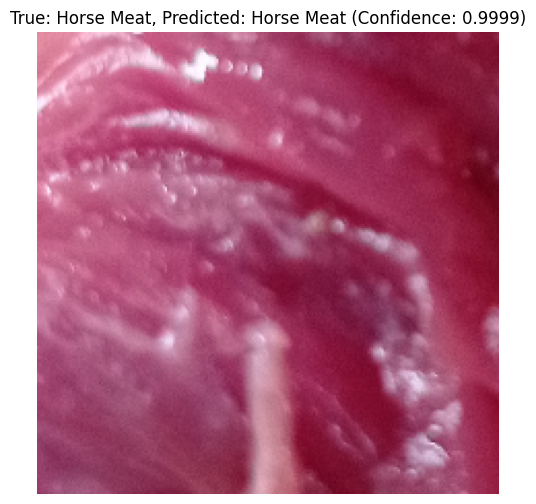

Predicting: /content/Jenis Daging/test/Horse Meat/IMG_20220110_110450.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step


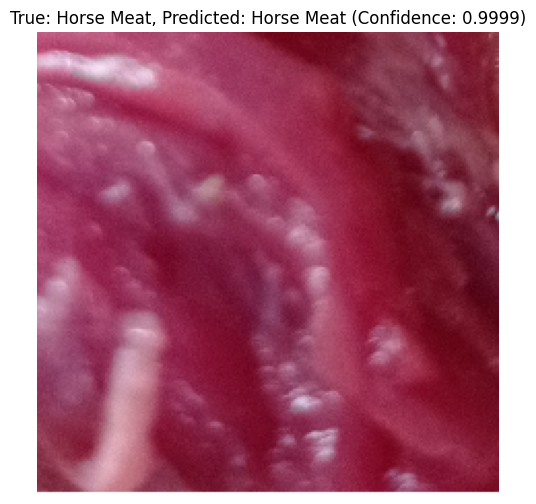

Predicting: /content/Jenis Daging/test/Horse Meat/IMG_20220110_110118.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


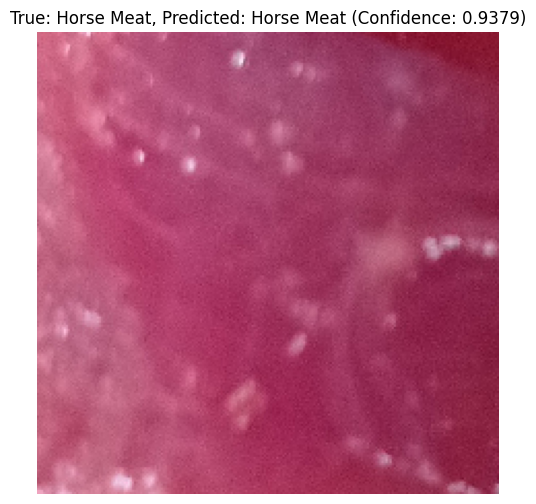

Predicting: /content/Jenis Daging/test/Horse Meat/IMG_20220110_105956.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


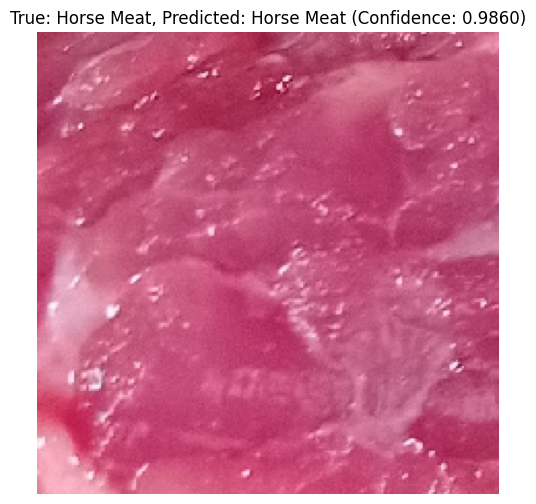

Predicting: /content/Jenis Daging/test/Horse Meat/IMG_20220110_110427.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


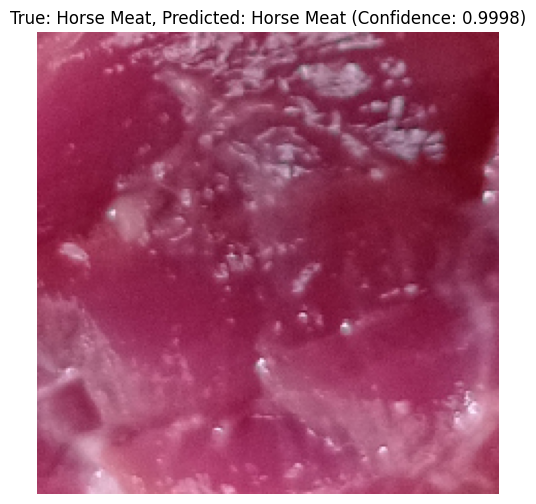

Predicting: /content/Jenis Daging/test/Horse Meat/IMG_20220110_110405.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


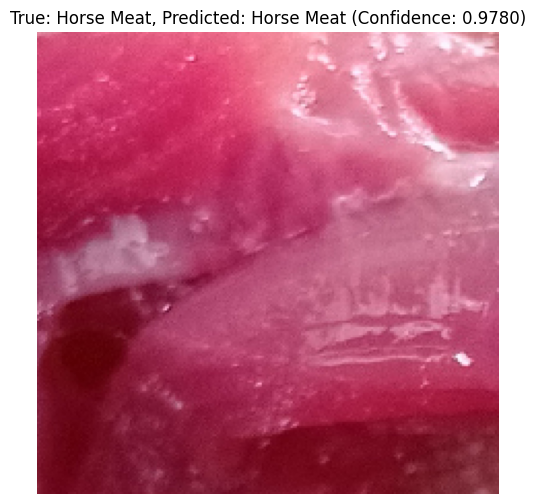

Predicting: /content/Jenis Daging/test/Horse Meat/IMG_20220110_110257.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


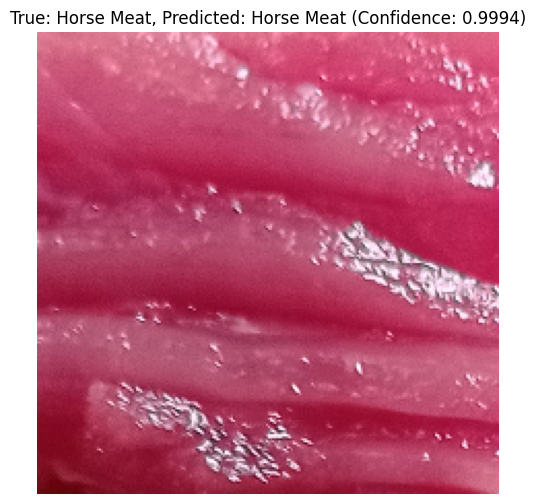

Predicting: /content/Jenis Daging/test/Horse Meat/IMG_20220110_110026.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


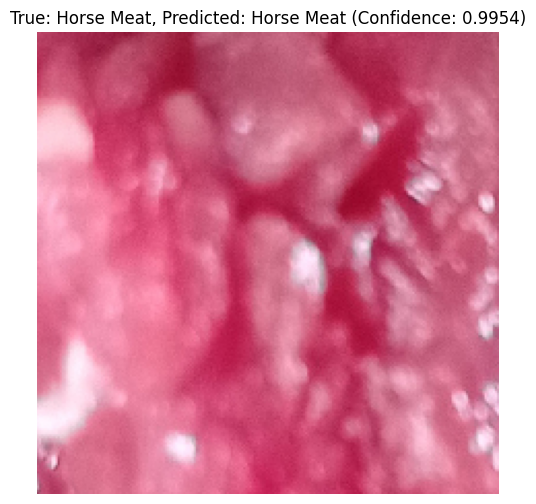

Predicting: /content/Jenis Daging/test/Horse Meat/IMG_20220110_110219.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


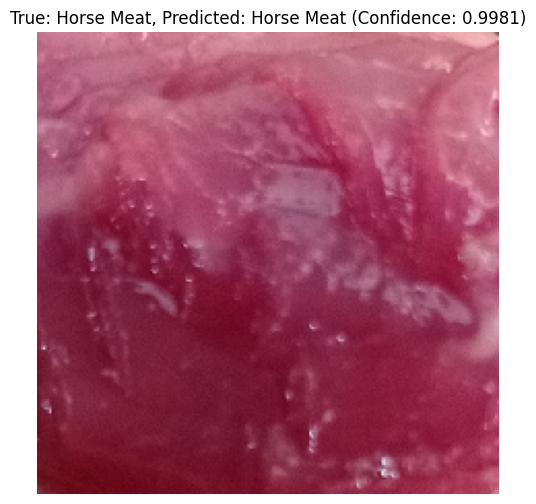

Predicting: /content/Jenis Daging/test/Horse Meat/IMG_20220110_110004.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


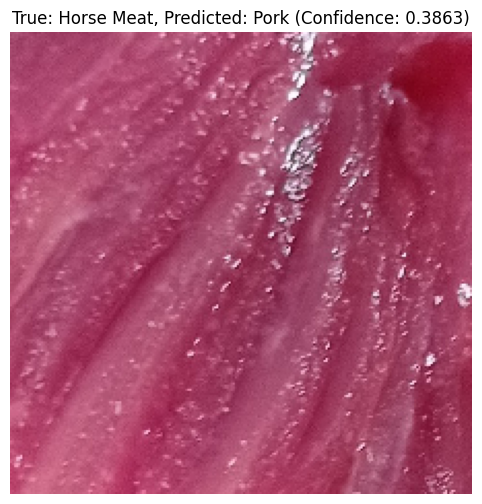

Predicting: /content/Jenis Daging/test/Horse Meat/IMG_20220110_110433.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


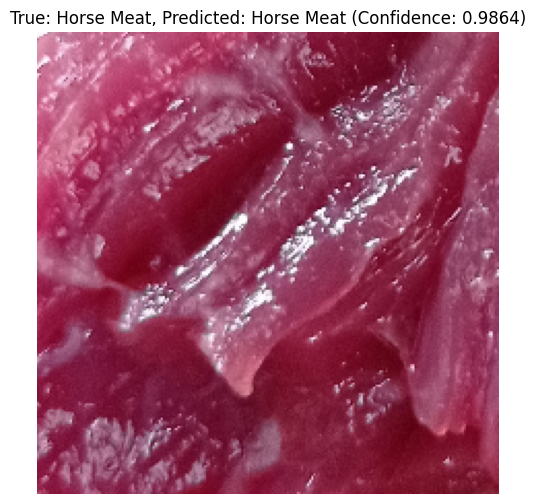


--- Predicting images in folder: Pork ---
Predicting: /content/Jenis Daging/test/Pork/IMG_20220110_094327.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


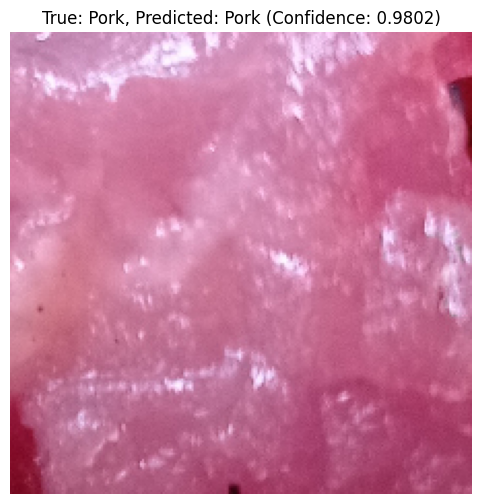

Predicting: /content/Jenis Daging/test/Pork/IMG_20220110_093540.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


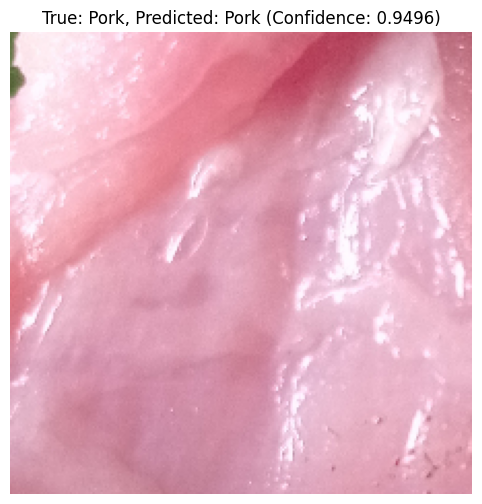

Predicting: /content/Jenis Daging/test/Pork/IMG_20220110_093425.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


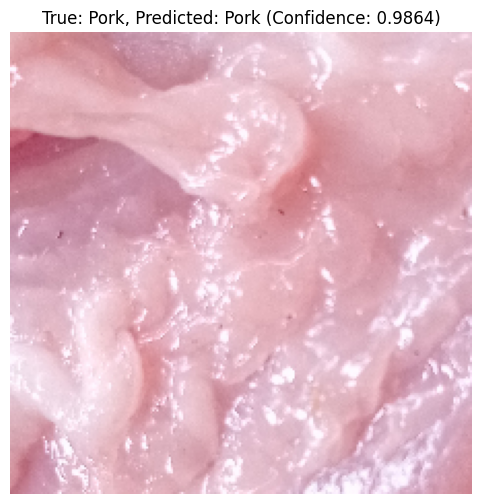

Predicting: /content/Jenis Daging/test/Pork/IMG_20220110_093143.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


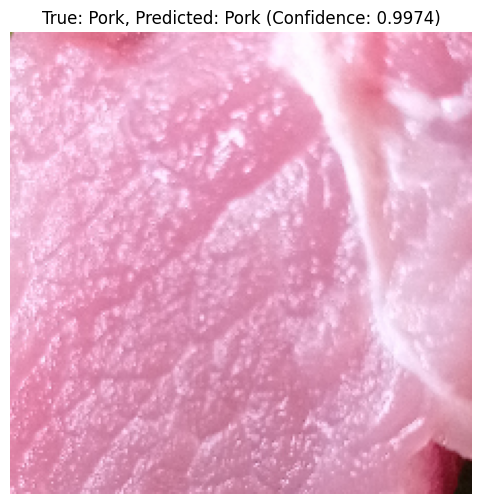

Predicting: /content/Jenis Daging/test/Pork/IMG_20220110_094532.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step


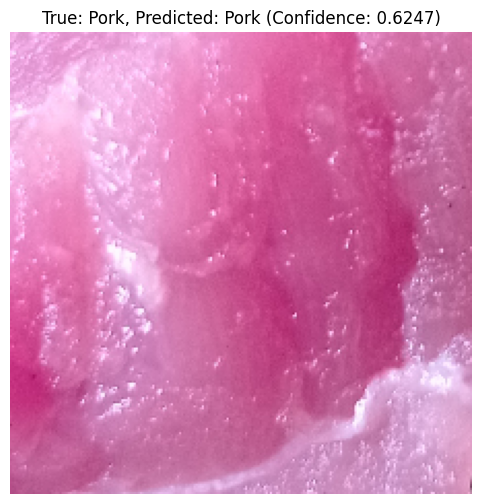

Predicting: /content/Jenis Daging/test/Pork/IMG_20220110_093406.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step


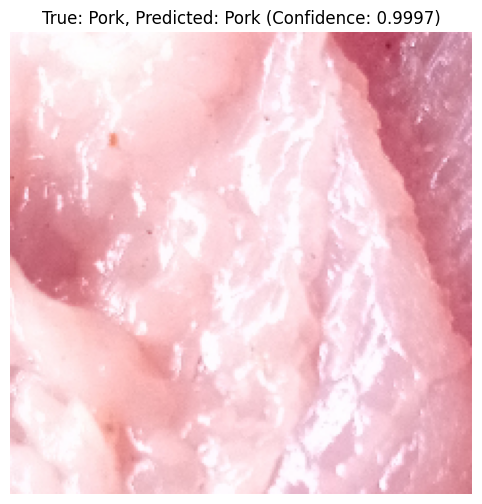

Predicting: /content/Jenis Daging/test/Pork/IMG_20220110_093457.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


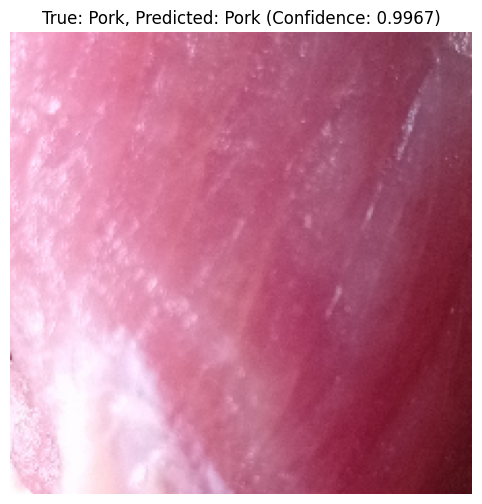

Predicting: /content/Jenis Daging/test/Pork/IMG_20220110_093351.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step


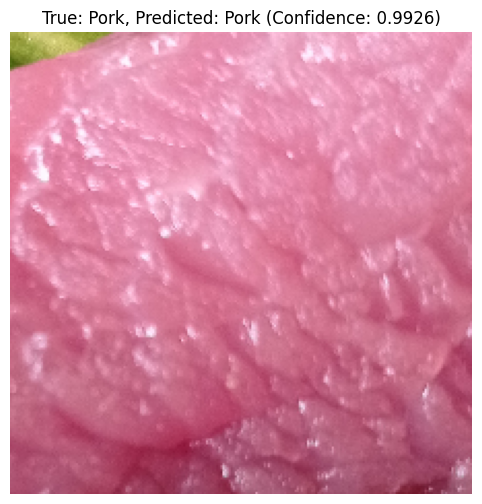

Predicting: /content/Jenis Daging/test/Pork/IMG_20220110_094740.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step


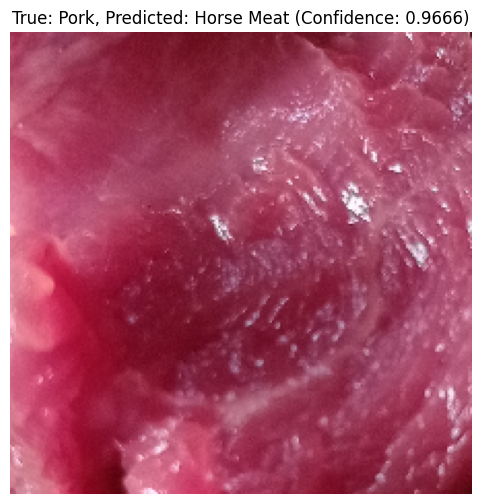

Predicting: /content/Jenis Daging/test/Pork/IMG_20220110_094316.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step


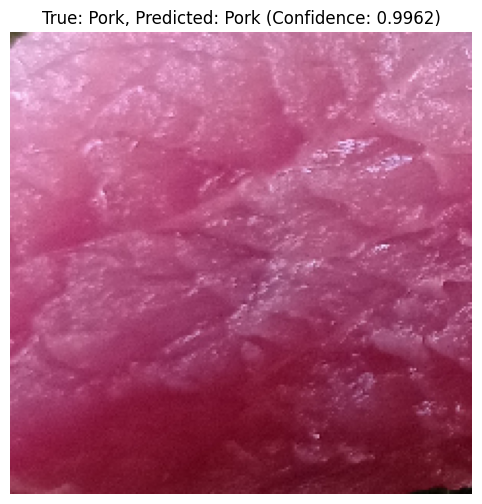

Predicting: /content/Jenis Daging/test/Pork/IMG_20220110_093152.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step


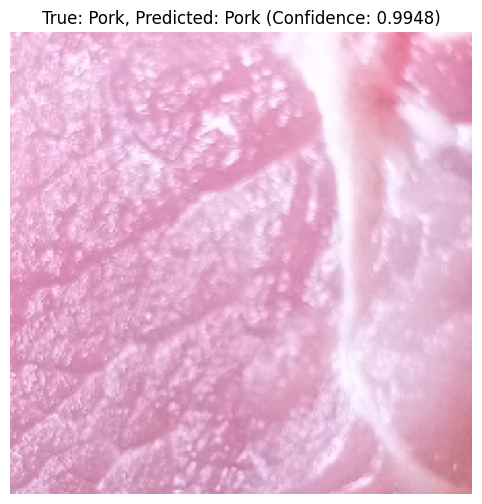

Predicting: /content/Jenis Daging/test/Pork/IMG_20220110_094658.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step


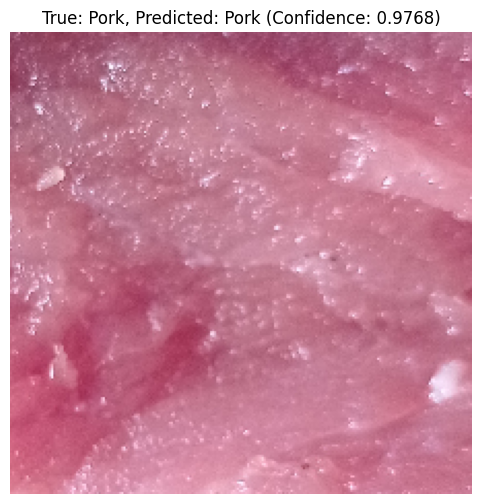

Predicting: /content/Jenis Daging/test/Pork/IMG_20220110_094402.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step


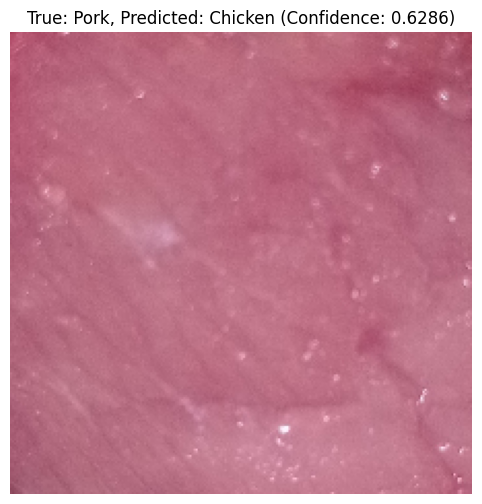

Predicting: /content/Jenis Daging/test/Pork/IMG_20220110_094155.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step


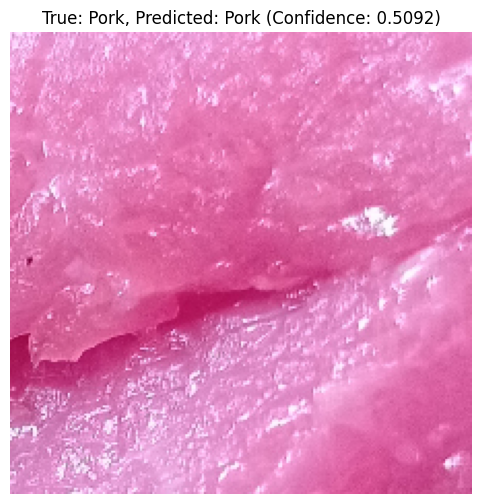


--- Predicting images in folder: Chicken ---
Predicting: /content/Jenis Daging/test/Chicken/segar_0017_jpg.rf.53f107e77a9e9d1c9229add21b3c6c9e.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step


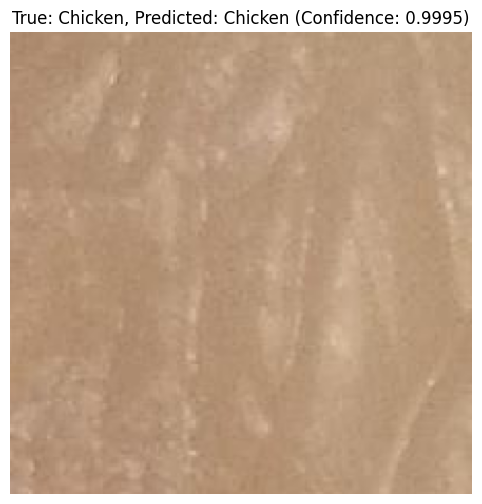

Predicting: /content/Jenis Daging/test/Chicken/segar_0010_jpg.rf.9d564290f4de8f56a0b4b75520ae4bc8.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step


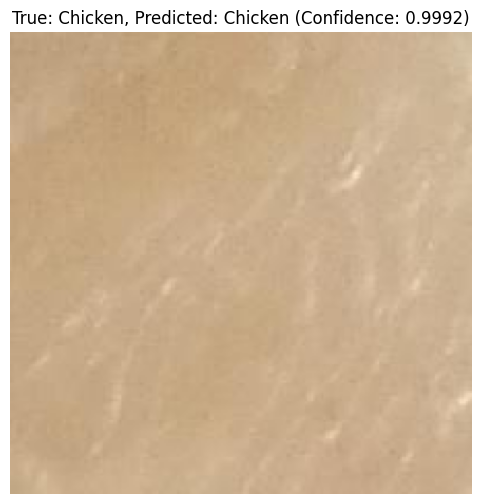

Predicting: /content/Jenis Daging/test/Chicken/segar_0021_jpg.rf.613604ec96395fd9b5f05946636eb461.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


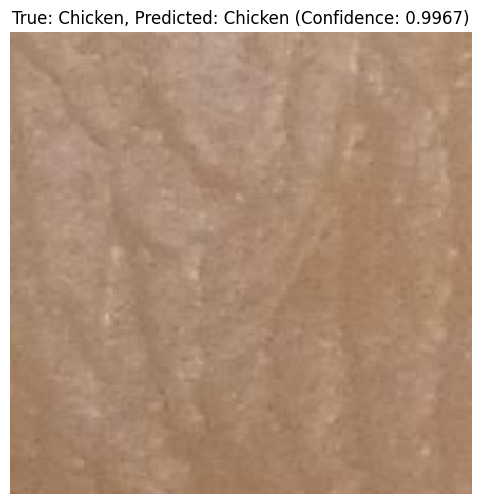

Predicting: /content/Jenis Daging/test/Chicken/segar_0020_jpg.rf.8c65321ff1eb2b4769ec4e61a2402b94.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step


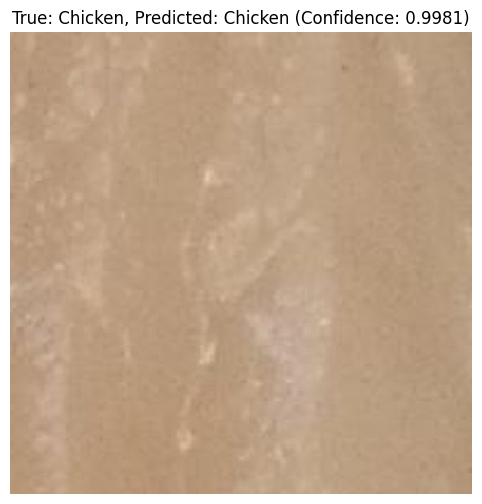

Predicting: /content/Jenis Daging/test/Chicken/segar_0006_jpg.rf.2b12e3ca3e3b28eeec14e171bab5f8be.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


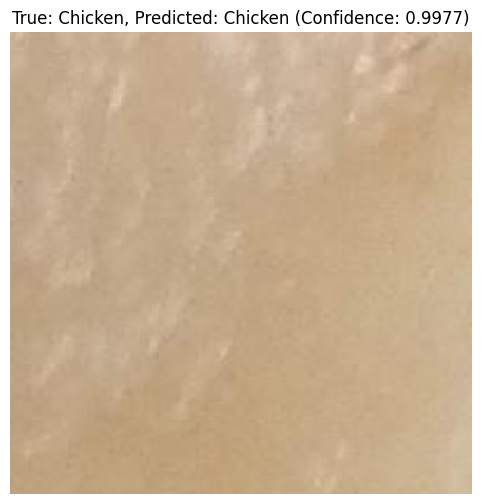

Predicting: /content/Jenis Daging/test/Chicken/segar_0015_jpg.rf.e5e2cb3459ffbe321cab291159c4a4c0.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step


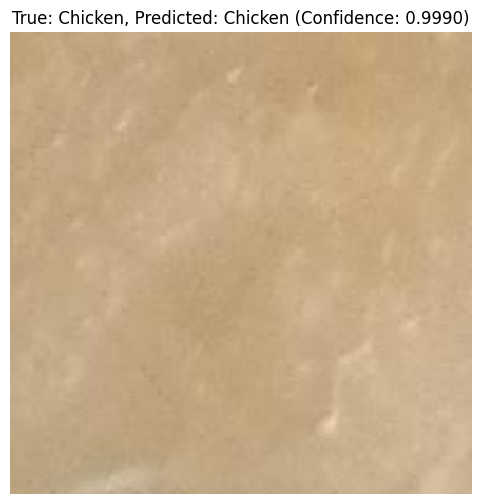

Predicting: /content/Jenis Daging/test/Chicken/segar_0002_jpg.rf.6a36c3f3000a35d008a15d9175c7dbf2.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step


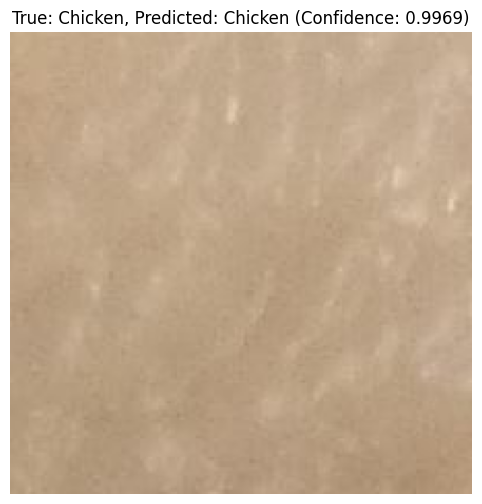

Predicting: /content/Jenis Daging/test/Chicken/segar_0016_jpg.rf.acc94ed1093f5b5096c0cbfb271b783f.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step


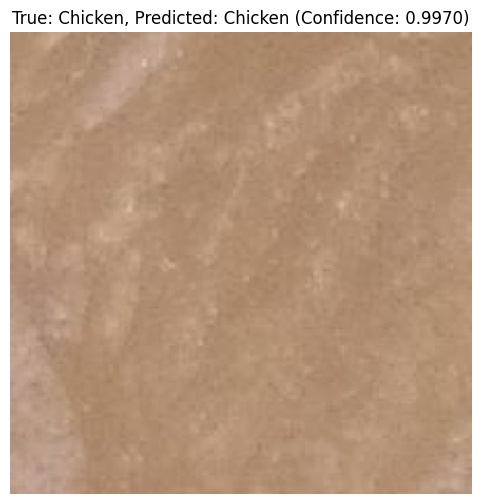

Predicting: /content/Jenis Daging/test/Chicken/segar_0011_jpg.rf.e3ce3b718334cbfb0de6f50317dcbfae.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step


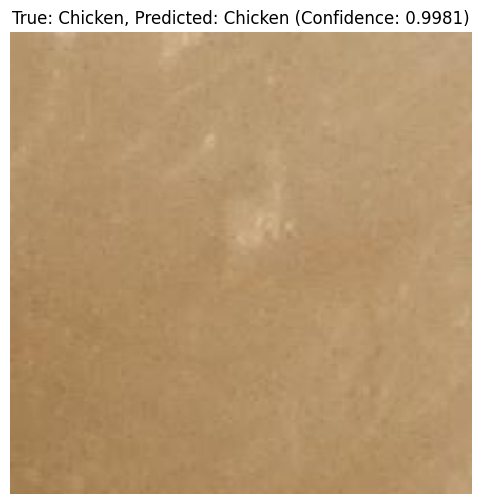

Predicting: /content/Jenis Daging/test/Chicken/segar_0022_jpg.rf.0d274ed22d5d88530538a65025ef507a.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step


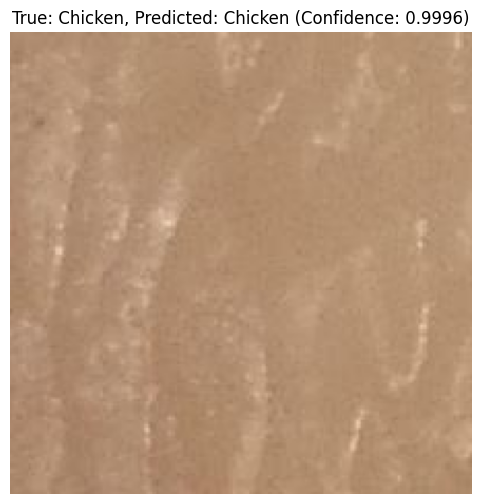

Predicting: /content/Jenis Daging/test/Chicken/segar_0007_jpg.rf.95121e5360a259e5e94a6c47ac9fa380.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step


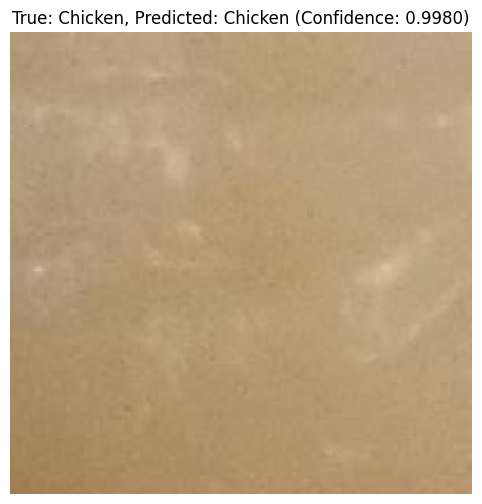

Predicting: /content/Jenis Daging/test/Chicken/segar_0001_jpg.rf.2b7c7688b49f27570b790639a49077a0.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step


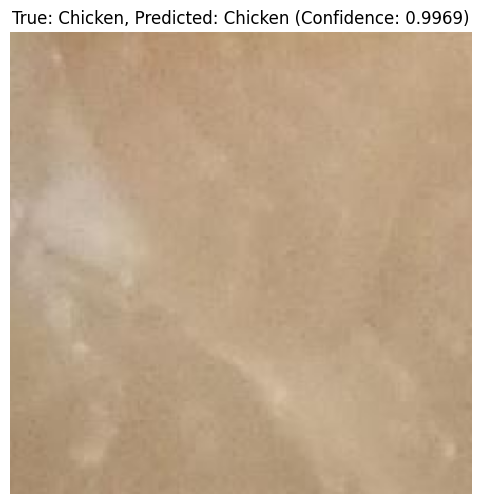

Predicting: /content/Jenis Daging/test/Chicken/segar_0012_jpg.rf.60716678c083f901ce955aae65d6d5a3.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step


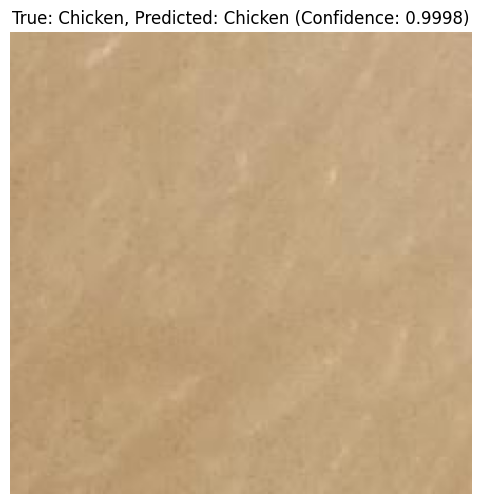

Predicting: /content/Jenis Daging/test/Chicken/segar_0008_jpg.rf.ba6330e175bd6155776e96ab15ea4def.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step


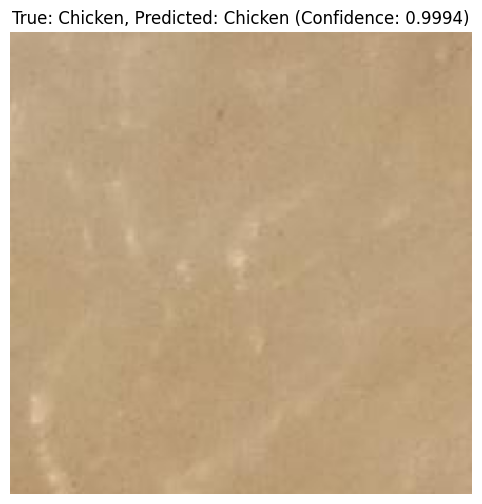

Predicting: /content/Jenis Daging/test/Chicken/segar_0003_jpg.rf.d9d9f18228956e2c55716cfdfec46d3d.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step


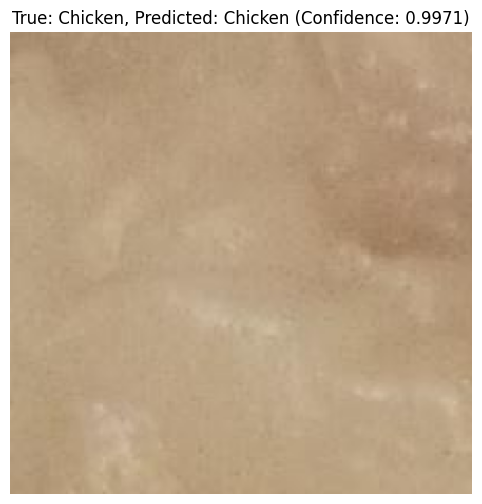

In [186]:

# Predict single image

results = predict_multiple_images(fine_tuned_model, TEST_PATH)

In [187]:
# download h5
from google.colab import files
fine_tuned_model.save('/content/fine_tuned_meat_model.h5')
model.save('/content/best_meat_model.h5')
files.download('/content/fine_tuned_meat_model.h5')
files.download('/content/best_meat_model.h5')




<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>